In [2]:
%config Completer.use_jedi = False

# Customer segmentation using clustering an classification (Simple)

https://archive.ics.uci.edu/ml/datasets/online+retail : 

이 데이터는 2010년 1월 20일 부터 2011년 9월 12일 까지의 기간동안 온라인 전자상거래 회사에서 발생한 transaction에 대한 내용입니다. 해당 회사는 UK-based non-store online 전자상거래 회사입니다.

이 데이터를 이용하여, 사용자의 행동을 분석합니다. 사용자의 행동을 분석하여, 사용자의 행동을 예측하는 모델을 만들겠습니다.

# 1. 데이터 로딩

In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
os.listdir("./inputs")

['HR-Employee-Attrition.csv',
 'housing.csv',
 'click_rates.csv',
 'ratings_test.txt',
 'selected_reviews',
 '.DS_Store',
 'winequality-data.csv',
 'weatherAUS.csv',
 'murders.csv',
 'creditcard.csv',
 'mercedes-benz-greener-manufacturing',
 'scores.csv',
 'DSES_math_Lecture17_Stacking_files',
 'ratings_train.txt',
 'df_funnel.csv',
 'train.csv',
 'german_dataset.csv',
 'state-population.csv',
 'four_sessions.csv',
 'web_page_data.csv',
 'german_credit_data.csv']

In [9]:
# West Europe countries retail transactions
dataset=pd.read_csv("inputs/e-commerce-data.csv",encoding = "ISO-8859-1") 
print(dataset.shape)
dataset.head()

(541909, 8)


,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,12/1/2010 8:26,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,12/1/2010 8:26,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,12/1/2010 8:26,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,12/1/2010 8:26,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,12/1/2010 8:26,3.39,17850.0,United Kingdom


# 2. 데이터 전처리

In [10]:
dataset.select_dtypes(include=['object']).columns

Index(['InvoiceNo', 'StockCode', 'Description', 'InvoiceDate', 'Country'], dtype='object')

In [12]:
dataset.select_dtypes(include=['object']).columns

Index(['InvoiceNo', 'StockCode', 'Description', 'InvoiceDate', 'Country'], dtype='object')

In [13]:
dataset.dtypes

InvoiceNo       object
StockCode       object
Description     object
Quantity         int64
InvoiceDate     object
UnitPrice      float64
CustomerID     float64
Country         object
dtype: object

In [14]:
dataset['Country'].dtype

dtype('O')

In [15]:
print(dataset.duplicated().sum())

5268


In [18]:
dataset.drop_duplicates(inplace = True) #아무생각없이 id겹치는거 안보고 다 지움, 아이템 하나 살때마다 invoicenumber가 찍히기 때문에 문제됨
dataset.shape

(536641, 8)

In [20]:
dataset.dropna(axis = 0, subset =['CustomerID'], inplace = True)
dataset.shape

(401604, 8)

In [22]:
print(pd.DataFrame(dataset.isnull().sum()))

             0
InvoiceNo    0
StockCode    0
Description  0
Quantity     0
InvoiceDate  0
UnitPrice    0
CustomerID   0
Country      0


In [15]:
# 반품이 있는 경우
dataset[(dataset.InvoiceNo).apply(lambda x: 'C' in x)].head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
141,C536379,D,Discount,-1,12/1/2010 9:41,27.50,14527.0,United Kingdom
154,C536383,35004C,SET OF 3 COLOURED FLYING DUCKS,-1,12/1/2010 9:49,4.65,15311.0,United Kingdom
235,C536391,22556,PLASTERS IN TIN CIRCUS PARADE,-12,12/1/2010 10:24,1.65,17548.0,United Kingdom
236,C536391,21984,PACK OF 12 PINK PAISLEY TISSUES,-24,12/1/2010 10:24,0.29,17548.0,United Kingdom
237,C536391,21983,PACK OF 12 BLUE PAISLEY TISSUES,-24,12/1/2010 10:24,0.29,17548.0,United Kingdom


In [27]:
dataset = dataset[(dataset.InvoiceNo).apply(lambda x: 'C' not in x)] #cancel 다 날려버림
dataset.shape

(392732, 8)

In [18]:
# 4339명의 transaction을 가지고 있다.
df_customerid_groups=dataset.groupby("CustomerID")
print(len(df_customerid_groups.groups))

4339


In [28]:
df_customerid_groups = dataset.groupby('CustomerID')
print(len(df_customerid_groups.groups))

4339


# 3. Clustering

In [29]:
df_cluster = pd.DataFrame(columns=['Quantity','UnitPrice','CustomerID'])

In [43]:
for k, v in (df_customerid_groups):
    print(k,v)

12346.0       InvoiceNo StockCode                     Description  Quantity  \
61619    541431     23166  MEDIUM CERAMIC TOP STORAGE JAR     74215   

           InvoiceDate  UnitPrice  CustomerID         Country  
61619  1/18/2011 10:01       1.04     12346.0  United Kingdom  
12347.0        InvoiceNo StockCode                          Description  Quantity  \
14938     537626     85116      BLACK CANDELABRA T-LIGHT HOLDER        12   
14939     537626     22375    AIRLINE BAG VINTAGE JET SET BROWN         4   
14940     537626     71477    COLOUR GLASS. STAR T-LIGHT HOLDER        12   
14941     537626     22492              MINI PAINT SET VINTAGE         36   
14942     537626     22771  CLEAR DRAWER KNOB ACRYLIC EDWARDIAN        12   
14943     537626     22772   PINK DRAWER KNOB ACRYLIC EDWARDIAN        12   
14944     537626     22773  GREEN DRAWER KNOB ACRYLIC EDWARDIAN        12   
14945     537626     22774    RED DRAWER KNOB ACRYLIC EDWARDIAN        12   
14946     537626    

[93 rows x 8 columns]
12393.0        InvoiceNo StockCode                        Description  Quantity  \
52263     540700     21581    SKULLS  DESIGN  COTTON TOTE BAG         6   
52264     540700     22619          SET OF 6 SOLDIER SKITTLES         8   
52265     540700    84997B  RED 3 PIECE RETROSPOT CUTLERY SET         6   
52266     540700     20727            LUNCH BAG  BLACK SKULL.        20   
52267     540700     20726                 LUNCH BAG WOODLAND        20   
52268     540700     22383            LUNCH BAG SUKI  DESIGN         10   
52269     540700     21249   WOODLAND  HEIGHT CHART STICKERS          6   
52270     540700     22378               WALL TIDY RETROSPOT         20   
52271     540700     22175                  PINK OWL SOFT TOY        12   
52272     540700     22176                  BLUE OWL SOFT TOY        12   
52273     540700    84997C  BLUE 3 PIECE POLKADOT CUTLERY SET         6   
52274     540700     20728                LUNCH BAG CARS BLUE        2

12425.0        InvoiceNo StockCode                          Description  Quantity  \
355385    567929     20723             STRAWBERRY CHARLOTTE BAG        10   
355386    567929     20724          RED RETROSPOT CHARLOTTE BAG        10   
355387    567929     23204          CHARLOTTE BAG APPLES DESIGN        10   
355388    567929    85099F                 JUMBO BAG STRAWBERRY        10   
355389    567929     20725              LUNCH BAG RED RETROSPOT        10   
355390    567929     21932      SCANDINAVIAN PAISLEY PICNIC BAG        10   
355391    567929     22383               LUNCH BAG SUKI DESIGN         10   
355392    567929     20728                  LUNCH BAG CARS BLUE        10   
355393    567929     21933      PINK VINTAGE PAISLEY PICNIC BAG        10   
355394    567929     22720    SET OF 3 CAKE TINS PANTRY DESIGN          3   
355395    567929     23245           SET OF 3 REGENCY CAKE TINS         4   
355396    567929     20751     FUNKY WASHING UP GLOVES ASSORTED     

492497  11/23/2011 10:28      40.00     12452.0  Switzerland  
12453.0        InvoiceNo StockCode                          Description  Quantity  \
282159    561627     22557     PLASTERS IN TIN VINTAGE PAISLEY         12   
282160    561627     22555            PLASTERS IN TIN STRONGMAN        12   
282161    561627     22321        BIRD DECORATION RED RETROSPOT        12   
282162    561627     22452         MEASURING TAPE BABUSHKA PINK         6   
282163    561627     22320          BIRDS MOBILE VINTAGE DESIGN         3   
282164    561627     22325               MOBILE VINTAGE HEARTS          3   
282165    561627     22467                    GUMBALL COAT RACK         6   
282166    561627     22602    RETROSPOT WOODEN HEART DECORATION        12   
282167    561627     21155                RED RETROSPOT PEG BAG         6   
282168    561627     22630                 DOLLY GIRL LUNCH BOX        12   
282169    561627     22629                  SPACEBOY LUNCH BOX         12   
28217

12483.0        InvoiceNo StockCode                          Description  Quantity  \
43419     540040     22264        FELT FARM ANIMAL WHITE BUNNY         48   
43420     540040    85169C          EAU DE NIL LOVE BIRD CANDLE        24   
43421     540040    85169A               IVORY LOVE BIRD CANDLE        24   
43422     540040    85169B               BLACK LOVE BIRD CANDLE        24   
43423     540040     22271                 FELTCRAFT DOLL ROSIE        12   
43424     540040     22749    FELTCRAFT PRINCESS CHARLOTTE DOLL        12   
43425     540040     21731        RED TOADSTOOL LED NIGHT LIGHT        48   
43426     540040     22466        FAIRY TALE COTTAGE NIGHTLIGHT        12   
43427     540040     22378                 WALL TIDY RETROSPOT         20   
43428     540040     22467                    GUMBALL COAT RACK        36   
43429     540040     20724          RED RETROSPOT CHARLOTTE BAG        20   
43430     540040     20704                    MR ROBOT SOFT TOY     

12518.0        InvoiceNo StockCode                          Description  Quantity  \
307358    563914     22898        CHILDRENS APRON APPLES DESIGN         8   
307359    563914     22367      CHILDRENS APRON SPACEBOY DESIGN         8   
307360    563914     22629                  SPACEBOY LUNCH BOX         12   
307361    563914     22551             PLASTERS IN TIN SPACEBOY        12   
307362    563914     22417       PACK OF 60 SPACEBOY CAKE CASES        24   
307363    563914     22534        MAGIC DRAWING SLATE SPACEBOY         24   
307364    563914     22964   3 PIECE SPACEBOY COOKIE CUTTER SET        12   
307365    563914     22617           BAKING SET SPACEBOY DESIGN         3   
307366    563914     23292               SPACEBOY CHILDRENS CUP         8   
307367    563914     23290              SPACEBOY CHILDRENS BOWL         8   
307368    563914     21680                   WOODLAND  STICKERS        12   
307369    563914     22326  ROUND SNACK BOXES SET OF4 WOODLAND      

205318  5/26/2011 12:38      28.00     12547.0   Spain  
12548.0        InvoiceNo StockCode                         Description  Quantity  \
240666    558108     21210  SET OF 72 RETROSPOT PAPER  DOILIES        12   
240667    558108     84988  SET OF 72 PINK HEART PAPER DOILIES        12   
240668    558108     21211      SET OF 72 SKULL PAPER  DOILIES        12   
240669    558108     84380   SET OF 3 BUTTERFLY COOKIE CUTTERS        12   
240670    558108      POST                             POSTAGE         1   

            InvoiceDate  UnitPrice  CustomerID Country  
240666  6/26/2011 15:35       1.45     12548.0   Spain  
240667  6/26/2011 15:35       1.45     12548.0   Spain  
240668  6/26/2011 15:35       1.45     12548.0   Spain  
240669  6/26/2011 15:35       1.25     12548.0   Spain  
240670  6/26/2011 15:35      28.00     12548.0   Spain  
12550.0        InvoiceNo StockCode                          Description  Quantity  \
350505    567653     23203             JUMBO BAG VI

157105   4/15/2011 8:45       2.89     12582.0  Finland  
12583.0        InvoiceNo StockCode                          Description  Quantity  \
26        536370     22728            ALARM CLOCK BAKELIKE PINK        24   
27        536370     22727            ALARM CLOCK BAKELIKE RED         24   
28        536370     22726           ALARM CLOCK BAKELIKE GREEN        12   
29        536370     21724      PANDA AND BUNNIES STICKER SHEET        12   
30        536370     21883                     STARS GIFT TAPE         24   
31        536370     10002          INFLATABLE POLITICAL GLOBE         48   
32        536370     21791   VINTAGE HEADS AND TAILS CARD GAME         24   
33        536370     21035      SET/2 RED RETROSPOT TEA TOWELS         18   
34        536370     22326  ROUND SNACK BOXES SET OF4 WOODLAND         24   
35        536370     22629                  SPACEBOY LUNCH BOX         24   
36        536370     22659              LUNCH BOX I LOVE LONDON        24   
37        

361624  9/26/2011 15:35      18.00     12612.0  Germany  
12613.0        InvoiceNo StockCode                         Description  Quantity  \
129321    547383     22720   SET OF 3 CAKE TINS PANTRY DESIGN         12   
129322    547383     20983  12 PENCILS TALL TUBE RED RETROSPOT        12   
129323    547383     21094       SET/6 RED SPOTTY PAPER PLATES        12   
129324    547383     21086         SET/6 RED SPOTTY PAPER CUPS        12   
129325    547383     21537          RED RETROSPOT PUDDING BOWL         4   
129326    547383     21533            RETROSPOT LARGE MILK JUG         3   
129327    547383     22139    RETROSPOT TEA SET CERAMIC 11 PC          3   
129328    547383     20981       12 PENCILS TALL TUBE WOODLAND        12   
129329    547383     21504                SKULLS GREETING CARD        12   
129330    547383     22993        SET OF 4 PANTRY JELLY MOULDS        12   
129331    547383    85099B             JUMBO BAG RED RETROSPOT        10   
129332    547383     2

12645.0        InvoiceNo StockCode                          Description  Quantity  \
73606     542369     22243    5 HOOK HANGER RED MAGIC TOADSTOOL        12   
73607     542369     22255                FELT TOADSTOOL  SMALL        12   
73608     542369     22264        FELT FARM ANIMAL WHITE BUNNY         12   
73609     542369     22254                 FELT TOADSTOOL LARGE        12   
73610     542369     21439                 BASKET OF TOADSTOOLS        12   
73611     542369     21580      RABBIT  DESIGN  COTTON TOTE BAG         6   
73612     542369     22244           3 HOOK HANGER MAGIC GARDEN        12   
73613     542369     22630                 DOLLY GIRL LUNCH BOX        12   
73614     542369     22631             CIRCUS PARADE LUNCH BOX         12   
73615     542369     22328   ROUND SNACK BOXES SET OF 4 FRUITS         12   
73616     542369     22492              MINI PAINT SET VINTAGE         36   
73617     542369     22551             PLASTERS IN TIN SPACEBOY     

[524 rows x 8 columns]
12683.0        InvoiceNo StockCode                          Description  Quantity  \
19838     537897      POST                              POSTAGE         1   
19839     537897     22601       CHRISTMAS RETROSPOT ANGEL WOOD        12   
19840     537897     22661      CHARLOTTE BAG DOLLY GIRL DESIGN        20   
19841     537897     22255                FELT TOADSTOOL  SMALL        12   
19842     537897     21731        RED TOADSTOOL LED NIGHT LIGHT        12   
19843     537897     22752         SET 7 BABUSHKA NESTING BOXES         2   
19844     537897    84029E       RED WOOLLY HOTTIE WHITE HEART.         4   
19845     537897     21481           FAWN BLUE HOT WATER BOTTLE         6   
19846     537897     22454          MEASURING TAPE BABUSHKA RED         6   
19847     537897     22558      CLOTHES PEGS RETROSPOT PACK 24         12   
19848     537897     22974             CHILDRENS DOLLY GIRL MUG        12   
19849     537897     20685                DOO

524159  12/4/2011 16:02      18.00     12724.0  France  
12725.0      InvoiceNo StockCode                          Description  Quantity  \
7214    537022     22791         T-LIGHT GLASS FLUTED ANTIQUE        12   
7215    537022     21287        SCENTED VELVET LOUNGE CANDLE         12   
7216    537022     79337        BLUE FLOCK GLASS CANDLEHOLDER         6   
7217    537022     85111  SILVER GLITTER FLOWER VOTIVE HOLDER        12   
7218    537022     85038      6 CHOCOLATE LOVE HEART T-LIGHTS         6   
7219    537022     22809              SET OF 6 T-LIGHTS SANTA         6   
7220    537022     22810            SET OF 6 T-LIGHTS SNOWMEN         6   
7221    537022     20956   PORCELAIN T-LIGHT HOLDERS ASSORTED        12   
7222    537022     22307     GOLD MUG BONE CHINA TREE OF LIFE         6   
7223    537022     85078    SCANDINAVIAN 3 HEARTS NAPKIN RING        24   
7224    537022    72802A    ROSE SCENT CANDLE IN JEWELLED BOX         6   
7225    537022    72803A    ROSE SC

[310 rows x 8 columns]
12769.0        InvoiceNo StockCode                         Description  Quantity  \
157299    550201     22423            REGENCY CAKESTAND 3 TIER        16   
157300    550201     22699    ROSES REGENCY TEACUP AND SAUCER         24   
157301    550201     22697     GREEN REGENCY TEACUP AND SAUCER        24   
157302    550201     22698      PINK REGENCY TEACUP AND SAUCER        24   
157303    550201     22366                    DOORMAT AIRMAIL         10   
157304    550201     21430  SET/3 RED GINGHAM ROSE STORAGE BOX        24   
157305    550201     22630                DOLLY GIRL LUNCH BOX        24   
157306    550201     22662         LUNCH BAG DOLLY GIRL DESIGN        10   
157307    550201     22629                 SPACEBOY LUNCH BOX         12   
157308    550201     22382          LUNCH BAG SPACEBOY DESIGN         10   
157309    550201   15056BL             EDWARDIAN PARASOL BLACK         3   
157310    550201    15056P              EDWARDIAN PARASOL

[91 rows x 8 columns]
12827.0        InvoiceNo StockCode                          Description  Quantity  \
420735    572907     23353       6 GIFT TAGS VINTAGE CHRISTMAS         12   
420736    572907     23349          ROLL WRAP VINTAGE CHRISTMAS        12   
420737    572907     22818               CARD CHRISTMAS VILLAGE        12   
420738    572907     23403        LETTER HOLDER HOME SWEET HOME         4   
420739    572907    47591D      PINK FAIRY CAKE CHILDRENS APRON         8   
420740    572907     22989       SET 2 PANTRY DESIGN TEA TOWELS         6   
420741    572907     23243  SET OF TEA COFFEE SUGAR TINS PANTRY         4   
420742    572907    47559B                  TEA TIME OVEN GLOVE        10   
420743    572907     23096                      PETIT TRAY CHIC        12   
420744    572907     22720    SET OF 3 CAKE TINS PANTRY DESIGN          3   
420745    572907     22722    SET OF 6 SPICE TINS PANTRY DESIGN         4   
420746    572907     22907     PACK OF 20 NAPK

276457  7/24/2011 13:03       0.83     12864.0  United Kingdom  
12865.0        InvoiceNo StockCode                         Description  Quantity  \
293439    562602     23293   SET OF 12 FAIRY CAKE BAKING CASES         8   
293440    562602     22844    VINTAGE CREAM DOG FOOD CONTAINER         2   
293441    562602     22845    VINTAGE CREAM CAT FOOD CONTAINER         2   
293442    562602     22712                    CARD DOLLY GIRL         12   
293443    562602     22029              SPACEBOY BIRTHDAY CARD        12   
293444    562602     22814                   CARD PARTY GAMES         12   
293445    562602     22665   RECIPE BOX BLUE SKETCHBOOK DESIGN         6   
293446    562602     84976           RECTANGULAR SHAPED MIRROR        12   
293447    562602     21402                     RED  EGG  SPOON        24   
293448    562602     21403                     BLUE EGG  SPOON        24   
293449    562602     20718           RED RETROSPOT SHOPPER BAG        10   
293450    56260

12906.0        InvoiceNo StockCode                          Description  Quantity  \
354528    567882     23188       VINTAGE  2 METER FOLDING RULER        24   
354529    567882     22561          WOODEN SCHOOL COLOURING SET        24   
354530    567882     22548         HEADS AND TAILS SPORTING FUN        72   
354531    567882     23202               JUMBO BAG VINTAGE LEAF        10   
354532    567882     23309  SET OF 60 I LOVE LONDON CAKE CASES         48   
354533    567882     22970                LONDON BUS COFFEE MUG        36   
354534    567882     22616           PACK OF 12 LONDON TISSUES         72   
354535    567882     23505         PLAYING CARDS I LOVE LONDON         36   
354536    567882     22900      SET 2 TEA TOWELS I LOVE LONDON         24   
354537    567882     23369    SET 36 COLOUR PENCILS LOVE LONDON       128   
354538    567882     23238    SET OF 4 KNICK KNACK TINS LONDON         96   
354539    567882     23190  BUNDLE OF 3 SCHOOL EXERCISE BOOKS       

[70 rows x 8 columns]
12944.0        InvoiceNo StockCode                          Description  Quantity  \
38279     539497     21623         VINTAGE UNION JACK MEMOBOARD         2   
38280     539497     21484          CHICK GREY HOT WATER BOTTLE         8   
38281     539497     20975  12 PENCILS SMALL TUBE RED RETROSPOT        24   
38282     539497     22398           MAGNETS PACK OF 4 SWALLOWS        12   
38283     539497     21039           RED RETROSPOT SHOPPING BAG        12   
38284     539497     21485     RETROSPOT HEART HOT WATER BOTTLE         3   
38285     539497     21166           COOK WITH WINE METAL SIGN         12   
38286     539497     22549                     PICTURE DOMINOES        24   
38287     539497     22622       BOX OF VINTAGE ALPHABET BLOCKS         4   
38288     539497     22491          PACK OF 12 COLOURED PENCILS        12   
38289     539497     21790                   VINTAGE SNAP CARDS        12   
38290     539497     22729          ALARM CLOC

[64 rows x 8 columns]
12990.0        InvoiceNo StockCode                          Description  Quantity  \
80268     543032    85099B              JUMBO BAG RED RETROSPOT        30   
80269     543032    85099F                 JUMBO BAG STRAWBERRY        10   
80270     543032     20711                      JUMBO BAG TOYS         10   
216953    555861     21931               JUMBO STORAGE BAG SUKI        20   
216954    555861    85099F                 JUMBO BAG STRAWBERRY        20   
216955    555861    85099C       JUMBO  BAG BAROQUE BLACK WHITE        20   
216956    555861    85099B              JUMBO BAG RED RETROSPOT        20   
448813    575071     22386              JUMBO BAG PINK POLKADOT        10   
448814    575071    85099C       JUMBO  BAG BAROQUE BLACK WHITE        10   
448815    575071    85099B              JUMBO BAG RED RETROSPOT        20   
448816    575071    85099F                 JUMBO BAG STRAWBERRY        10   
448817    575071     21929       JUMBO BAG PIN

34736  12/17/2010 14:23       5.95     13033.0  United Kingdom  
13034.0        InvoiceNo StockCode                          Description  Quantity  \
9527      537205     22251    BIRDHOUSE DECORATION MAGIC GARDEN        12   
9528      537205     22252  BIRDCAGE DECORATION TEALIGHT HOLDER        12   
9529      537205     22135                LADLE LOVE HEART PINK        12   
9530      537205     22131     FOOD CONTAINER SET 3 LOVE HEART          6   
9531      537205     22231           JIGSAW TREE WITH BIRDHOUSE        12   
9532      537205     21035      SET/2 RED RETROSPOT TEA TOWELS          6   
9533      537205     20754      RETROSPOT RED WASHING UP GLOVES         6   
9534      537205     21385      IVORY HANGING DECORATION  HEART        24   
9535      537205     22470                HEART OF WICKER LARGE         6   
9536      537205     22469                HEART OF WICKER SMALL        12   
9537      537205     84879        ASSORTED COLOUR BIRD ORNAMENT         8   
399

[73 rows x 8 columns]
13083.0        InvoiceNo StockCode                       Description  Quantity  \
358251    568139     22752      SET 7 BABUSHKA NESTING BOXES         2   
358252    568139     22420            LIPSTICK PEN BABY PINK        12   
358253    568139     22421              LIPSTICK PEN FUSCHIA        12   
358254    568139     22419                  LIPSTICK PEN RED        12   
358255    568139     22754      SMALL RED BABUSHKA NOTEBOOK         12   
358256    568139     22758  LARGE PURPLE BABUSHKA NOTEBOOK          12   
358257    568139     22779        WOODEN OWLS LIGHT GARLAND          4   
358258    568139     22780    LIGHT GARLAND BUTTERFILES PINK         4   
358259    568139     23158       SET OF 5 LUCKY CAT MAGNETS         12   
358260    568139     21231    SWEETHEART CERAMIC TRINKET BOX        12   
358261    568139     21731     RED TOADSTOOL LED NIGHT LIGHT        12   
358262    568139     85178              VICTORIAN SEWING KIT        12   
358263  

[140 rows x 8 columns]
13127.0        InvoiceNo StockCode                          Description  Quantity  \
355874    567976     23320         GIANT 50'S CHRISTMAS CRACKER        12   
355875    567976     20719               WOODLAND CHARLOTTE BAG        10   
355876    567976     22138        BAKING SET 9 PIECE RETROSPOT          3   
355877    567976     22910    PAPER CHAIN KIT VINTAGE CHRISTMAS         6   
355878    567976     23216            LAUREL HEART ANTIQUE GOLD        12   
355879    567976     23077                  DOUGHNUT LIP GLOSS         20   
355880    567976     22632            HAND WARMER RED RETROSPOT        12   
355881    567976     23247           BISCUIT TIN 50'S CHRISTMAS         6   
355882    567976     23298                       SPOTTY BUNTING         3   
355883    567976    47590A          BLUE HAPPY BIRTHDAY BUNTING         3   
355884    567976    47590B          PINK HAPPY BIRTHDAY BUNTING         3   
355885    567976     22720    SET OF 3 CAKE T

527093  12/5/2011 15:51       2.55     13173.0  United Kingdom  
13174.0        InvoiceNo StockCode                          Description  Quantity  \
9911      537224     22829            SWEETHEART WIRE WALL TIDY         2   
9912      537224     70007            HI TEC ALPINE HAND WARMER         1   
9913      537224     84375        SET OF 20 KIDS COOKIE CUTTERS         2   
9915      537224     70006             LOVE HEART POCKET WARMER         1   
9916      537224    85025C         PINK HEART SHAPE PHOTO FRAME         1   
9917      537224     22866        HAND WARMER SCOTTY DOG DESIGN         1   
9918      537224     22086      PAPER CHAIN KIT 50'S CHRISTMAS          1   
9919      537224     21202              DOLLY HONEYCOMB GARLAND         1   
9920      537224     22294           HEART FILIGREE DOVE  SMALL         7   
9921      537224     35971       ROSE FOLKART HEART DECORATIONS         4   
9922      537224     35971       ROSE FOLKART HEART DECORATIONS         3   
992

201107  5/23/2011 13:03       3.75     13223.0  United Kingdom  
13224.0        InvoiceNo StockCode                          Description  Quantity  \
258815    559673     22052            VINTAGE CARAVAN GIFT WRAP        21   
258816    559673     21892   TRADITIONAL WOODEN CATCH CUP GAME          6   
258817    559673     22621           TRADITIONAL KNITTING NANCY         6   
258818    559673     22960             JAM MAKING SET WITH JARS         4   
258819    559673     22907     PACK OF 20 NAPKINS PANTRY DESIGN         6   
258820    559673     22136               LOVE HEART SOCK HANGER         7   
258821    559673     23298                       SPOTTY BUNTING         6   
258822    559673     23300   GARDENERS KNEELING PAD CUP OF TEA          3   
258823    559673     23301    GARDENERS KNEELING PAD KEEP CALM          3   
258824    559673     23302       KNEELING MAT HOUSEWORK  DESIGN         3   
258825    559673     22077               6 RIBBONS RUSTIC CHARM         6   
258

[90 rows x 8 columns]
13266.0        InvoiceNo StockCode                        Description  Quantity  \
135299    547891     10125            MINI FUNKY DESIGN TAPES        20   
135300    547891     22754       SMALL RED BABUSHKA NOTEBOOK         12   
135301    547891     22755    SMALL PURPLE BABUSHKA NOTEBOOK         12   
135302    547891     21397             BLUE POLKADOT EGG CUP         48   
135303    547891     21399           BLUE POLKADOT COFFEE MUG        48   
135304    547891     21398           RED POLKADOT COFFEE  MUG        48   
135305    547891     85093         CANDY SPOT EGG WARMER HARE        48   
135306    547891     22321      BIRD DECORATION RED RETROSPOT        12   
135307    547891     22260         FELT EGG COSY BLUE RABBIT         12   
135308    547891     22975         SPACEBOY CHILDRENS EGG CUP        24   
135309    547891     22083          PAPER CHAIN KIT RETROSPOT         6   
135310    547891     22551           PLASTERS IN TIN SPACEBOY        1

[72 rows x 8 columns]
13311.0        InvoiceNo StockCode                          Description  Quantity  \
260242    559806     22716                   CARD CIRCUS PARADE        12   
260243    559806     22030               SWALLOWS GREETING CARD        12   
260244    559806     22715                     CARD WEDDING DAY        12   
260245    559806     21504                 SKULLS GREETING CARD        12   
260246    559806     22023                 EMPIRE BIRTHDAY CARD        12   
260247    559806     23007               SPACEBOY BABY GIFT SET         1   
260248    559806     20702                   PINK PADDED MOBILE         3   
260249    559806     23077                  DOUGHNUT LIP GLOSS         40   
260250    559806     22084               PAPER CHAIN KIT EMPIRE        10   
260251    559806     23072  MARIE ANTOINETTE TRINKET BOX SILVER         2   
260252    559806     22120        WELCOME  WOODEN BLOCK LETTERS         2   
260253    559806    72807B   SET/3 OCEAN SCENT

375927  10/4/2011 12:55       1.45     13351.0  United Kingdom  
13352.0        InvoiceNo StockCode                          Description  Quantity  \
388370    570426     21498                  RED RETROSPOT WRAP         25   
388371    570426     21499                   BLUE POLKADOT WRAP        25   
388372    570426     22820                    GIFT BAG BIRTHDAY        12   
388373    570426     22692          DOORMAT WELCOME TO OUR HOME         2   
388374    570426     21524       DOORMAT SPOTTY HOME SWEET HOME         2   
388375    570426    85025B  EAU DE NILE HEART SHAPE PHOTO FRAME        12   
388376    570426     21442           GREEN BIRDHOUSE DECORATION        12   
388377    570426     22341           LOVE GARLAND PAINTED ZINC         12   
388378    570426     22892    SET OF SALT AND PEPPER TOADSTOOLS        12   
388379    570426     21231       SWEETHEART CERAMIC TRINKET BOX        12   
388380    570426     22645  CERAMIC HEART FAIRY CAKE MONEY BANK        12   
388

363999  9/28/2011 10:56       4.15     13397.0  United Kingdom  
13398.0        InvoiceNo StockCode                          Description  Quantity  \
208076    555094     23101        SILVER STARS TABLE DECORATION        12   
208077    555094     23102       SILVER HEARTS TABLE DECORATION        12   
208078    555094     23300   GARDENERS KNEELING PAD CUP OF TEA         12   
208079    555094     21922    UNION STRIPE WITH FRINGE  HAMMOCK         2   
208080    555094     22927       GREEN GIANT GARDEN THERMOMETER         6   
208081    555094     22925        BLUE GIANT GARDEN THERMOMETER         6   
208082    555094     21896                   POTTING SHED TWINE         6   
208083    555094     22191               IVORY DINER WALL CLOCK         2   
208084    555094     22194               BLACK DINER WALL CLOCK         2   
208085    555094     21163   DO NOT TOUCH MY STUFF DOOR HANGER         12   
208086    555094     21248         DOOR HANGER  MUM + DADS ROOM        12   
208

[71 rows x 8 columns]
13451.0        InvoiceNo StockCode                          Description  Quantity  \
50046     540545     22412      METAL SIGN NEIGHBOURHOOD WITCH          5   
50047     540545     21181         PLEASE ONE PERSON METAL SIGN         4   
50048     540545     21174     POTTERING IN THE SHED METAL SIGN        12   
50049     540545     22577  WOODEN HEART CHRISTMAS SCANDINAVIAN        31   
50050     540545     22180                       RETROSPOT LAMP         4   
50051     540545     22062  CERAMIC BOWL WITH LOVE HEART DESIGN         2   
50052     540545     21671         RED SPOT CERAMIC DRAWER KNOB        12   
50053     540545     22066               LOVE HEART TRINKET POT         4   
50054     540545     22469                HEART OF WICKER SMALL         1   
50055     540545    16161P                   WRAP ENGLISH ROSE         25   
50056     540545     21498                  RED RETROSPOT WRAP         25   
50057     540545     22198                LARG

279605  7/26/2011 14:25       7.95     13492.0  Switzerland  
13493.0        InvoiceNo StockCode                     Description  Quantity  \
102735    545034     22858             EASTER TIN KEEPSAKE        60   
102736    545034     22222       CAKE PLATE LOVEBIRD WHITE         3   
102737    545034     22236  CAKE STAND 3 TIER MAGIC GARDEN         2   
102738    545034      POST                         POSTAGE         1   
115569    546134     22860    EASTER TIN CHICKS PINK DAISY        60   
115570    546134     22858             EASTER TIN KEEPSAKE       108   
115571    546134     22857       ASSORTED EASTER GIFT TAGS       144   
115572    546134      POST                         POSTAGE         2   

            InvoiceDate  UnitPrice  CustomerID      Country  
102735  2/25/2011 16:42       1.65     13493.0  Switzerland  
102736  2/25/2011 16:42       4.95     13493.0  Switzerland  
102737  2/25/2011 16:42      12.75     13493.0  Switzerland  
102738  2/25/2011 16:42      40.0

[217 rows x 8 columns]
13529.0        InvoiceNo StockCode                       Description  Quantity  \
196299    553835     23254     CHILDRENS CUTLERY DOLLY GIRL          4   
196300    553835     23256       CHILDRENS CUTLERY SPACEBOY          4   
196301    553835     22662       LUNCH BAG DOLLY GIRL DESIGN        10   
196302    553835     22472         TV DINNER TRAY DOLLY GIRL         3   
196303    553835     22474           SPACEBOY TV DINNER TRAY         3   
196304    553835     23007            SPACEBOY BABY GIFT SET         3   
196305    553835     23008          DOLLY GIRL BABY GIFT SET         3   
352857    567698     23390          DOLLY GIRL MINI BACKPACK         4   
352858    567698     23389            SPACEBOY MINI BACKPACK         4   
352859    567698     22121        NOEL WOODEN BLOCK LETTERS          3   
352860    567698     22119        PEACE WOODEN BLOCK LETTERS         3   
352861    567698     23388            WOODLAND MINI BACKPACK         4   
352862 

151620  4/10/2011 13:36       0.79     13570.0  United Kingdom  
13571.0        InvoiceNo StockCode                          Description  Quantity  \
140848    548484     82582            AREA PATROLLED METAL SIGN         2   
140849    548484     21907            I'M ON HOLIDAY METAL SIGN         2   
140850    548484     21187  WHITE BELL HONEYCOMB PAPER GARLAND          4   
140851    548484     22090              PAPER BUNTING RETROSPOT         1   
140852    548484     22892    SET OF SALT AND PEPPER TOADSTOOLS         2   
140853    548484     22197                 SMALL POPCORN HOLDER        15   
140854    548484     22700             BLACK AND WHITE DOG BOWL         1   
140855    548484     21733     RED HANGING HEART T-LIGHT HOLDER         2   
140856    548484    85123A   WHITE HANGING HEART T-LIGHT HOLDER         2   
140857    548484     23183         MOTHER'S KITCHEN SPOON REST          1   
140858    548484     22667                RECIPE BOX RETROSPOT          3   
140

13614.0        InvoiceNo StockCode                          Description  Quantity  \
56166     541087     22914         BLUE COAT RACK PARIS FASHION         3   
56167     541087     22912       YELLOW COAT RACK PARIS FASHION         3   
56168     541087     22913          RED COAT RACK PARIS FASHION         3   
56169     541087     22925        BLUE GIANT GARDEN THERMOMETER         2   
56170     541087     22720    SET OF 3 CAKE TINS PANTRY DESIGN          3   
56171     541087     22722    SET OF 6 SPICE TINS PANTRY DESIGN         4   
56172     541087     22847          BREAD BIN DINER STYLE IVORY         2   
56173     541087     22846           BREAD BIN DINER STYLE RED          3   
56174     541087     22849           BREAD BIN DINER STYLE MINT         2   
242482    558355     22211               WOOD STAMP SET FLOWERS         3   
242483    558355     10133         COLOURING PENCILS BROWN TUBE         4   
242484    558355     22993         SET OF 4 PANTRY JELLY MOULDS     

[63 rows x 8 columns]
13654.0        InvoiceNo StockCode                          Description  Quantity  \
117338    546383    85206A         CREAM FELT EASTER EGG BASKET         6   
117339    546383     22859             EASTER TIN BUNNY BOUQUET         6   
117340    546383     22148               EASTER CRAFT 4 CHICKS         12   
117341    546383     22241          GARLAND WOODEN HAPPY EASTER        12   
117342    546383     35922                  EASTER BUNNY WREATH         5   
117343    546383     85093           CANDY SPOT EGG WARMER HARE        48   
117344    546383     22975           SPACEBOY CHILDRENS EGG CUP        12   
117345    546383     22977         DOLLY GIRL CHILDRENS EGG CUP        12   
117346    546383     22262                FELT EGG COSY CHICKEN        12   
117347    546383     21507            ELEPHANT, BIRTHDAY CARD,         12   
117348    546383     21506           FANCY FONT BIRTHDAY CARD,         12   
117349    546383     22983                  CA

70713  1/25/2011 13:10       9.95     13703.0  United Kingdom  
13704.0        InvoiceNo StockCode                          Description  Quantity  \
337150    566432     23245           SET OF 3 REGENCY CAKE TINS         8   
337151    566432     22708                      WRAP DOLLY GIRL        25   
337152    566432     23231                 WRAP  VINTAGE DOILY         25   
337153    566432    16156S               WRAP PINK FAIRY CAKES         25   
337154    566432    85230G                 ORANGE VOTIVE CANDLE        24   
337155    566432    16161P                   WRAP ENGLISH ROSE         25   
339575    566600     23298                       SPOTTY BUNTING         6   
339576    566600     47566                        PARTY BUNTING         8   
339577    566600     16008  SMALL FOLDING SCISSOR(POINTED EDGE)        24   
339578    566600     23397          FOOT STOOL HOME SWEET HOME          4   
339579    566600     23403        LETTER HOLDER HOME SWEET HOME         8   
3395

[313 rows x 8 columns]
13743.0        InvoiceNo StockCode                        Description  Quantity  \
134044    547820     22560         TRADITIONAL MODELLING CLAY        24   
134045    547820     22493          PAINT YOUR OWN CANVAS SET        12   
134046    547820     22561        WOODEN SCHOOL COLOURING SET        24   
134047    547820     21891   TRADITIONAL WOODEN SKIPPING ROPE        12   
134048    547820     22492            MINI PAINT SET VINTAGE         36   
134049    547820     84077  WORLD WAR 2 GLIDERS ASSTD DESIGNS        48   
177954    552197     22491        PACK OF 12 COLOURED PENCILS        12   
177955    552197     22560         TRADITIONAL MODELLING CLAY        24   
177956    552197     22493          PAINT YOUR OWN CANVAS SET        24   
177957    552197     22561        WOODEN SCHOOL COLOURING SET        24   
177958    552197     21891   TRADITIONAL WOODEN SKIPPING ROPE        12   
177959    552197     22492            MINI PAINT SET VINTAGE         

513095   11/30/2011 9:33       1.06     13784.0  United Kingdom  
13786.0       InvoiceNo StockCode                         Description  Quantity  \
14789    537619    85123A  WHITE HANGING HEART T-LIGHT HOLDER        32   
14790    537619    84970S   HANGING HEART ZINC T-LIGHT HOLDER        24   
14791    537619     21915              RED  HARMONICA IN BOX         24   
14792    537619    46000S        POLYESTER FILLER PAD 40x40cm        12   
14793    537619     21622    VINTAGE UNION JACK CUSHION COVER         8   
14794    537619     21914              BLUE HARMONICA IN BOX         24   
14795    537619    84970L    SINGLE HEART ZINC T-LIGHT HOLDER        12   

           InvoiceDate  UnitPrice  CustomerID         Country  
14789  12/7/2010 13:53       2.55     13786.0  United Kingdom  
14790  12/7/2010 13:53       0.85     13786.0  United Kingdom  
14791  12/7/2010 13:53       1.25     13786.0  United Kingdom  
14792  12/7/2010 13:53       1.45     13786.0  United Kingdom  
14793

229356  6/16/2011 13:48       9.95     13826.0  United Kingdom  
13827.0        InvoiceNo StockCode                          Description  Quantity  \
270743    560584     22499            WOODEN UNION JACK BUNTING         1   
270744    560584     20685                DOORMAT RED RETROSPOT         1   
270745    560584     22644       CERAMIC CHERRY CAKE MONEY BANK         1   
270746    560584     22645  CERAMIC HEART FAIRY CAKE MONEY BANK         1   
270747    560584     22646   CERAMIC STRAWBERRY CAKE MONEY BANK         2   
270748    560584     22062  CERAMIC BOWL WITH LOVE HEART DESIGN         1   
270749    560584     37448      CERAMIC CAKE DESIGN SPOTTED MUG         1   
270750    560584     21363              HOME SMALL WOOD LETTERS         1   
270751    560584     22320          BIRDS MOBILE VINTAGE DESIGN         1   
270752    560584     22649         STRAWBERRY FAIRY CAKE TEAPOT         1   
270753    560584     22317         FIVE CATS HANGING DECORATION         1   
270

[336 rows x 8 columns]
13873.0        InvoiceNo StockCode                          Description  Quantity  \
80640     543046     22722    SET OF 6 SPICE TINS PANTRY DESIGN         4   
80641     543046     22788                   BROCANTE COAT RACK         2   
80642     543046    82494L          WOODEN FRAME ANTIQUE WHITE          6   
80643     543046     22784                LANTERN CREAM GAZEBO          3   
80644     543046     21717                    EASTER TIN BUCKET         8   
80645     543046     22777                   GLASS CLOCHE LARGE         2   
80646     543046     22778                   GLASS CLOCHE SMALL         4   
175111    551882     85141        JARDIN ETCHED GLASS FRUITBOWL         4   
175112    551882     21470        FLOWER VINE RAFFIA FOOD COVER         6   
175113    551882     22423             REGENCY CAKESTAND 3 TIER         1   
175114    551882     84755  COLOUR GLASS T-LIGHT HOLDER HANGING        16   
175115    551882     22722    SET OF 6 SPICE 

411275  10/21/2011 12:25       3.45     13918.0  United Kingdom  
13919.0        InvoiceNo StockCode                      Description  Quantity  \
296185    562853     22567          20 DOLLY PEGS RETROSPOT        24   
296186    562853     23547               WRAP FLOWER SHOP          25   
296187    562853     23546               WRAP PAISLEY PARK         25   
296188    562853     22704                 WRAP RED APPLES         25   
296189    562853     22707                WRAP MONSTER FUN         25   
296190    562853     23233             WRAP POPPIES  DESIGN        25   
296191    562853     22961           JAM MAKING SET PRINTED        12   
296192    562853    16161P               WRAP ENGLISH ROSE         25   
296193    562853    16161U            WRAP SUKI AND FRIENDS        25   
296194    562853     21498              RED RETROSPOT WRAP         25   
296195    562853     21499               BLUE POLKADOT WRAP        25   
296196    562853     21500              PINK POLKA

13963.0       InvoiceNo StockCode                          Description  Quantity  \
14052    537447     22568                FELTCRAFT CUSHION OWL         8   
14053    537447     22569          FELTCRAFT CUSHION BUTTERFLY         4   
14054    537447     22570             FELTCRAFT CUSHION RABBIT         8   
14055    537447     22644       CERAMIC CHERRY CAKE MONEY BANK        12   
14056    537447     22645  CERAMIC HEART FAIRY CAKE MONEY BANK        12   
14057    537447     37450    CERAMIC CAKE BOWL + HANGING CAKES         6   
14058    537447     84665        SQUARE CHERRY BLOSSOM CABINET         4   
42698    540017     22222            CAKE PLATE LOVEBIRD WHITE        12   
42699    540017     22342           HOME GARLAND PAINTED ZINC         24   
42700    540017     22343       PARTY PIZZA DISH RED RETROSPOT        24   
42701    540017     22473       TV DINNER TRAY VINTAGE PAISLEY         8   
42702    540017     22511          RETROSPOT BABUSHKA DOORSTOP         8   
4270

13999.0        InvoiceNo StockCode                          Description  Quantity  \
27924     538567     20675                   BLUE POLKADOT BOWL         8   
27925     538567     20676                   RED RETROSPOT BOWL         8   
27926     538567     20677                   PINK POLKADOT BOWL         8   
27927     538567     21238                    RED RETROSPOT CUP        16   
27928     538567     21239                   PINK  POLKADOT CUP         8   
27929     538567     21240                    BLUE POLKADOT CUP         8   
27930     538567     22052            VINTAGE CARAVAN GIFT WRAP        25   
27931     538567     22086      PAPER CHAIN KIT 50'S CHRISTMAS         12   
27932     538567     22348          TEA BAG PLATE RED RETROSPOT        24   
27933     538567     22411    JUMBO SHOPPER VINTAGE RED PAISLEY        10   
27934     538567     22480         RED TEA TOWEL CLASSIC DESIGN        24   
27935     538567     22481       BLACK TEA TOWEL CLASSIC DESIGN     

14032.0        InvoiceNo StockCode                         Description  Quantity  \
17312     537707     22837          HOT WATER BOTTLE BABUSHKA          4   
17313     537707     22969        HOMEMADE JAM SCENTED CANDLES        12   
17314     537707     22973        CHILDREN'S CIRCUS PARADE MUG        12   
17315     537707     22976    CIRCUS PARADE CHILDRENS EGG CUP         12   
17316     537707     22988                   SOLDIERS EGG CUP         12   
17317     537707     79067                 CORONA MEXICAN TRAY         8   
17318     537707     22636  CHILDS BREAKFAST SET CIRCUS PARADE         2   
17319     537707     22441   GROW YOUR OWN BASIL IN ENAMEL MUG         8   
17320     537707     22902              TOTE BAG I LOVE LONDON        12   
17321     537707     22900     SET 2 TEA TOWELS I LOVE LONDON          6   
17322     537707     22659             LUNCH BOX I LOVE LONDON        12   
17323     537707     22064          PINK DOUGHNUT TRINKET POT         12   
1732

14060.0        InvoiceNo StockCode                          Description  Quantity  \
3753      536673     21014        SWISS CHALET TREE DECORATION         60   
3754      536673     21803       CHRISTMAS TREE STAR DECORATION        36   
3755      536673     21801  CHRISTMAS TREE DECORATION WITH BELL        36   
3756      536673     72816    SET/3 CHRISTMAS DECOUPAGE CANDLES        48   
3757      536673     22909  SET OF 20 VINTAGE CHRISTMAS NAPKINS        96   
3758      536673     40016        CHINESE DRAGON PAPER LANTERNS       144   
3759      536673     22491          PACK OF 12 COLOURED PENCILS        48   
3760      536673     21791   VINTAGE HEADS AND TAILS CARD GAME         36   
17756     537774    85199L  LARGE HANGING IVORY & RED WOOD BIRD        36   
17757     537774     84347  ROTATING SILVER ANGELS T-LIGHT HLDR        48   
17758     537774     84945   MULTI COLOUR SILVER T-LIGHT HOLDER        72   
17759     537774     22144       CHRISTMAS CRAFT LITTLE FRIENDS     

14102.0        InvoiceNo StockCode                          Description  Quantity  \
419840    572861    90019C          SILVER BLACK ORBIT BRACELET         1   
419841    572861    90018B       GOLD M.O.P ORBIT DROP EARRINGS         1   
419842    572861    90014B           GOLD M.O.P. ORBIT NECKLACE         1   
419843    572861     23028       DRAWER KNOB CRACKLE GLAZE BLUE         3   
419844    572861     21668       RED STRIPE CERAMIC DRAWER KNOB         6   
419846    572861     22771  CLEAR DRAWER KNOB ACRYLIC EDWARDIAN        36   
419847    572861     23542              WALL ART 70'S ALPHABET          6   
419848    572861     22775  PURPLE DRAWERKNOB ACRYLIC EDWARDIAN        12   
419849    572861     22774    RED DRAWER KNOB ACRYLIC EDWARDIAN        12   
419853    572861     21317     GLASS SPHERE CANDLE STAND MEDIUM         1   
419854    572861     22182  CAKE STAND VICTORIAN FILIGREE SMALL         1   
419858    572861     21669      BLUE STRIPE CERAMIC DRAWER KNOB     

14141.0        InvoiceNo StockCode                          Description  Quantity  \
314789    564656     23263    SET OF 3 WOODEN HEART DECORATIONS        24   
314790    564656     21485     RETROSPOT HEART HOT WATER BOTTLE         3   
314791    564656     22112           CHOCOLATE HOT WATER BOTTLE         3   
314792    564656     22508             DOORSTOP RETROSPOT HEART         4   
314793    564656     20707         CRAZY DAISY HEART DECORATION        12   
314794    564656     21114        LAVENDER SCENTED FABRIC HEART        10   
314795    564656     22602    RETROSPOT WOODEN HEART DECORATION        12   
314796    564656     82600                NO SINGING METAL SIGN        12   
314797    564656     21174     POTTERING IN THE SHED METAL SIGN        12   
314798    564656     21907            I'M ON HOLIDAY METAL SIGN        12   
314799    564656     23243  SET OF TEA COFFEE SUGAR TINS PANTRY         4   
314800    564656     23168         CLASSIC CAFE SUGAR DISPENSER     

[318 rows x 8 columns]
14179.0        InvoiceNo StockCode                         Description  Quantity  \
404570    571682     21034        REX CASH+CARRY JUMBO SHOPPER         1   
404571    571682     22169    FAMILY ALBUM WHITE PICTURE FRAME         1   
404572    571682     22867             HAND WARMER BIRD DESIGN         2   
404573    571682     23439          HAND WARMER RED LOVE HEART         2   
404574    571682     23035           DRAWER KNOB CERAMIC IVORY         2   
404575    571682     22197                      POPCORN HOLDER         4   
404576    571682     22352   LUNCH BOX WITH CUTLERY RETROSPOT          1   
404577    571682     23035           DRAWER KNOB CERAMIC IVORY        24   
404578    571682     23517    EMBROIDERED RIBBON REEL REBECCA          1   
404579    571682     23518     EMBROIDERED RIBBON REEL RACHEL          1   
404580    571682     23516    EMBROIDERED RIBBON REEL SOPHIE           1   
404581    571682     23100       SILVER BELLS TABLE DECOR

[193 rows x 8 columns]
14222.0        InvoiceNo StockCode                          Description  Quantity  \
228692    556942     21498                  RED RETROSPOT WRAP         25   
228693    556942     22029               SPACEBOY BIRTHDAY CARD        12   
228694    556942     22712                     CARD DOLLY GIRL         12   
228695    556942     22714                 CARD BIRTHDAY COWBOY        12   
228696    556942     22776          SWEETHEART CAKESTAND 3 TIER         1   
228697    556942     20982          12 PENCILS TALL TUBE SKULLS        12   
228698    556942     20983   12 PENCILS TALL TUBE RED RETROSPOT        12   
228699    556942     22741                       FUNKY DIVA PEN        48   
228700    556942     22740                         POLKADOT PEN        48   
228701    556942     23192  BUNDLE OF 3 ALPHABET EXERCISE BOOKS        12   
228702    556942     22149           FELTCRAFT 6 FLOWER FRIENDS         6   
228703    556942     20972   PINK CREAM FELT 

[111 rows x 8 columns]
14259.0        InvoiceNo StockCode                   Description  Quantity  \
273260    560805     22079    RIBBON REEL HEARTS DESIGN         20   
273261    560805     22077        6 RIBBONS RUSTIC CHARM        24   
273262    560805    15058A  BLUE POLKADOT GARDEN PARASOL         2   
273263    560805     22081    RIBBON REEL FLORA + FAUNA         10   
273264    560805    85049G        CHOCOLATE BOX RIBBONS         12   

            InvoiceDate  UnitPrice  CustomerID         Country  
273260  7/21/2011 10:44       1.65     14259.0  United Kingdom  
273261  7/21/2011 10:44       1.65     14259.0  United Kingdom  
273262  7/21/2011 10:44       7.95     14259.0  United Kingdom  
273263  7/21/2011 10:44       1.65     14259.0  United Kingdom  
273264  7/21/2011 10:44       1.25     14259.0  United Kingdom  
14261.0        InvoiceNo StockCode                          Description  Quantity  \
353103    567742     23300   GARDENERS KNEELING PAD CUP OF TEA         12

14297.0        InvoiceNo StockCode                          Description  Quantity  \
115851    546156     22634       CHILDS BREAKFAST SET SPACEBOY          4   
115852    546156     22662          LUNCH BAG DOLLY GIRL DESIGN        10   
115853    546156     22630                 DOLLY GIRL LUNCH BOX        12   
115854    546156     22635     CHILDS BREAKFAST SET DOLLY GIRL          4   
115855    546156     22725       ALARM CLOCK BAKELIKE CHOCOLATE         4   
115856    546156     22726           ALARM CLOCK BAKELIKE GREEN         4   
115857    546156     22727            ALARM CLOCK BAKELIKE RED          4   
115858    546156     22899         CHILDREN'S APRON DOLLY GIRL          6   
115859    546156     22367      CHILDRENS APRON SPACEBOY DESIGN         8   
115860    546156     22382           LUNCH BAG SPACEBOY DESIGN         10   
115861    546156     22629                  SPACEBOY LUNCH BOX         12   
387200    570272     23263    SET OF 3 WOODEN HEART DECORATIONS     

14341.0        InvoiceNo StockCode                          Description  Quantity  \
71161     542111     22411    JUMBO SHOPPER VINTAGE RED PAISLEY        10   
71162     542111    85099F                 JUMBO BAG STRAWBERRY        10   
71163     542111     20725              LUNCH BAG RED RETROSPOT        10   
71164     542111     22969         HOMEMADE JAM SCENTED CANDLES        12   
71165     542111     22842              BISCUIT TIN VINTAGE RED         2   
71166     542111     22841         ROUND CAKE TIN VINTAGE GREEN         2   
71167     542111     22840           ROUND CAKE TIN VINTAGE RED         2   
71168     542111     22843            BISCUIT TIN VINTAGE GREEN         2   
71169     542111     22189              CREAM HEART CARD HOLDER         4   
71170     542111     84978     HANGING HEART JAR T-LIGHT HOLDER        12   
71171     542111     22457      NATURAL SLATE HEART CHALKBOARD          6   
71172     542111     23232          WRAP VINTAGE PETALS  DESIGN     

433375  11/1/2011 15:53       9.95     14383.0  United Kingdom  
14385.0        InvoiceNo StockCode                          Description  Quantity  \
472189    576671     20727              LUNCH BAG  BLACK SKULL.        10   
472190    576671     23344            JUMBO BAG 50'S CHRISTMAS         10   
472191    576671     22661      CHARLOTTE BAG DOLLY GIRL DESIGN        10   
472192    576671    85071A  BLUE CHARLIE+LOLA PERSONAL DOORSIGN        24   
494937    578284     47480       HANGING PHOTO CLIP ROPE LADDER        12   
494938    578284     23367      SET 12 COLOUR PENCILS SPACEBOY         16   
494939    578284     20840         FRENCH FLORAL CUSHION COVER         12   
494940    578284     23202               JUMBO BAG VINTAGE LEAF        10   
494941    578284     23368    SET 12 COLOUR PENCILS DOLLY GIRL         16   
515869    579789     21485     RETROSPOT HEART HOT WATER BOTTLE         3   
515870    579789     21429       RED GINGHAM ROSE JEWELLERY BOX         8   
515

14419.0        InvoiceNo StockCode                          Description  Quantity  \
23289     538197     21754             HOME BUILDING BLOCK WORD         1   
23290     538197     22725       ALARM CLOCK BAKELIKE CHOCOLATE         1   
23291     538197     22728            ALARM CLOCK BAKELIKE PINK         2   
23292     538197     22725       ALARM CLOCK BAKELIKE CHOCOLATE         2   
23293     538197     10135         COLOURING PENCILS BROWN TUBE         4   
23294     538197     22112           CHOCOLATE HOT WATER BOTTLE         1   
23295     538197     22551             PLASTERS IN TIN SPACEBOY         2   
23296     538197     22555            PLASTERS IN TIN STRONGMAN         3   
23297     538197     22554     PLASTERS IN TIN WOODLAND ANIMALS         3   
23298     538197     22557     PLASTERS IN TIN VINTAGE PAISLEY          3   
23299     538197     22556       PLASTERS IN TIN CIRCUS PARADE          3   
23300     538197     20977             36 PENCILS TUBE WOODLAND     

307567  8/21/2011 14:19       0.42     14460.0  United Kingdom  
14461.0        InvoiceNo StockCode                          Description  Quantity  \
130517    547497    90036F  FLOWER GLASS GARLD NECKL36"TURQUOIS         4   
130518    547497    90036D  FLOWER GLASS GARLAND NECKL.36"BLACK         4   
130519    547497    90199A        5 STRAND GLASS NECKLACE BLACK         4   
130520    547497    90030B      RED KUKUI COCONUT SEED NECKLACE         4   
130521    547497    90180A        BLACK+WHITE NECKLACE W TASSEL         4   
130522    547497     90062                    CARNIVAL BRACELET         4   
130523    547497     90131          PINK/AMETHYST/GOLD NECKLACE         4   
130524    547497     22964   3 PIECE SPACEBOY COOKIE CUTTER SET         1   
130525    547497     21866          UNION JACK FLAG LUGGAGE TAG         4   
130526    547497     21867         PINK UNION JACK  LUGGAGE TAG         4   
130527    547497     22978                   PANTRY ROLLING PIN         6   
130

[164 rows x 8 columns]
14504.0        InvoiceNo StockCode                         Description  Quantity  \
110797    545697     84879       ASSORTED COLOUR BIRD ORNAMENT         8   
110798    545697     21260                       FIRST AID TIN         1   
110799    545697    82494L         WOODEN FRAME ANTIQUE WHITE          1   
110800    545697     82482   WOODEN PICTURE FRAME WHITE FINISH         1   
110801    545697     22791        T-LIGHT GLASS FLUTED ANTIQUE         2   
110802    545697     84947   ANTIQUE SILVER TEA GLASS ENGRAVED         2   
110803    545697     21993          FLORAL FOLK STATIONERY SET         1   
110804    545697     22984                  CARD GINGHAM ROSE         12   
110805    545697     21507           ELEPHANT, BIRTHDAY CARD,         12   
110806    545697     22030              SWALLOWS GREETING CARD        12   
110807    545697     21509  COWBOYS AND INDIANS BIRTHDAY CARD         12   
110808    545697    85123A  WHITE HANGING HEART T-LIGHT H

394956  10/13/2011 10:54       3.39     14537.0  United Kingdom  
14538.0        InvoiceNo StockCode                          Description  Quantity  \
136221    547942     22499            WOODEN UNION JACK BUNTING         6   
136222    547942    85123A   WHITE HANGING HEART T-LIGHT HOLDER        18   
136223    547942     22457      NATURAL SLATE HEART CHALKBOARD          6   
380149    569734     23396    LE JARDIN BOTANIQUE CUSHION COVER         4   
380150    569734     21621           VINTAGE UNION JACK BUNTING         4   
380151    569734     22470                HEART OF WICKER LARGE         6   
380152    569734     35970            ZINC FOLKART SLEIGH BELLS        12   
380153    569734     23313            VINTAGE CHRISTMAS BUNTING         5   
380154    569734     23318       BOX OF 6 MINI VINTAGE CRACKERS         6   
380155    569734     23247           BISCUIT TIN 50'S CHRISTMAS         6   
380156    569734     22573     STAR WOODEN CHRISTMAS DECORATION        12   
38

[262 rows x 8 columns]
14573.0        InvoiceNo StockCode                          Description  Quantity  \
5141      536846     22469                HEART OF WICKER SMALL         2   
5142      536846     21754             HOME BUILDING BLOCK WORD         2   
5143      536846     22666      RECIPE BOX PANTRY YELLOW DESIGN         1   
5144      536846     22665    RECIPE BOX BLUE SKETCHBOOK DESIGN         1   
5145      536846     22667                RECIPE BOX RETROSPOT          1   
5146      536846     22752         SET 7 BABUSHKA NESTING BOXES         2   
5147      536846     22776          SWEETHEART CAKESTAND 3 TIER         1   
5148      536846     20914  SET/5 RED RETROSPOT LID GLASS BOWLS         3   
5149      536846     22427              ENAMEL FLOWER JUG CREAM         1   
5150      536846     22794        SWEETHEART WIRE MAGAZINE RACK         2   
5151      536846     22426               ENAMEL WASH BOWL CREAM         1   
5152      536846     22424               ENAM

14621.0        InvoiceNo StockCode                          Description  Quantity  \
33087     539222     22179              SET 10 LIGHTS NIGHT OWL         6   
33088     539222     22468         BABUSHKA LIGHTS STRING OF 10         4   
33089     539222     10133         COLOURING PENCILS BROWN TUBE        10   
33090     539222     20726                   LUNCH BAG WOODLAND        10   
33091     539222     20728                  LUNCH BAG CARS BLUE        10   
33092     539222     22384              LUNCH BAG PINK POLKADOT        10   
33093     539222     22382           LUNCH BAG SPACEBOY DESIGN         10   
33094     539222     22167           OVAL WALL MIRROR DIAMANTE          4   
33095     539222     20981        12 PENCILS TALL TUBE WOODLAND        12   
33096     539222     20982          12 PENCILS TALL TUBE SKULLS        12   
33097     539222     21931               JUMBO STORAGE BAG SUKI        10   
33098     539222     22386              JUMBO BAG PINK POLKADOT     

[80 rows x 8 columns]
14657.0        InvoiceNo StockCode                          Description  Quantity  \
59707     541406     22059        CERAMIC STRAWBERRY DESIGN MUG         3   
59708     541406     22417       PACK OF 60 SPACEBOY CAKE CASES         6   
59709     541406    84459B          YELLOW METAL CHICKEN HEART          3   
59710     541406    84459A            PINK METAL CHICKEN HEART          3   
59711     541406     22964   3 PIECE SPACEBOY COOKIE CUTTER SET         3   
59712     541406     84380    SET OF 3 BUTTERFLY COOKIE CUTTERS         3   
59713     541406     22937      BAKING MOULD CHOCOLATE CUPCAKES         1   
59714     541406     22262                FELT EGG COSY CHICKEN         5   
59715     541406     22261          FELT EGG COSY WHITE RABBIT          5   
59716     541406     21454                 PAINTED PINK RABBIT          3   
59717     541406     22228      BUNNY WOODEN PAINTED WITH BIRD          3   
59718     541406     22229    BUNNY WOODEN PAI

[71 rows x 8 columns]
14692.0        InvoiceNo StockCode                          Description  Quantity  \
66429     541795     22720    SET OF 3 CAKE TINS PANTRY DESIGN          4   
66430     541795     22967  SET 3 SONG BIRD PAPER EGGS ASSORTED         4   
66431     541795     22957  SET 3 PAPER VINTAGE CHICK PAPER EGG         3   
66432     541795     22470                HEART OF WICKER LARGE         2   
66433     541795     22469                HEART OF WICKER SMALL         3   
66434     541795     22931   BAKING MOULD HEART WHITE CHOCOLATE         1   
66435     541795     22961               JAM MAKING SET PRINTED         6   
66436     541795     22721        SET OF 3 CAKE TINS SKETCHBOOK         2   
66437     541795     21385      IVORY HANGING DECORATION  HEART        24   
66438     541795     22789    T-LIGHT HOLDER SWEETHEART HANGING         4   
66439     541795     22079           RIBBON REEL HEARTS DESIGN         10   
66440     541795     22588            CARD HOL

[259 rows x 8 columns]
14725.0        InvoiceNo StockCode                          Description  Quantity  \
468671    576538     23555         LANDMARK FRAME NOTTING HILL          1   
468672    576538     23558        LANDMARK FRAME LONDON BRIDGE          1   
468673    576538     23556        LANDMARK FRAME COVENT GARDEN          1   
468674    576538     23554         LANDMARK FRAME OXFORD STREET         1   
468675    576538     23553          LANDMARK FRAME CAMDEN TOWN          1   
468676    576538     21484          CHICK GREY HOT WATER BOTTLE         1   
468678    576538     23557         LANDMARK FRAME BAKER STREET          1   
468683    576538     22029               SPACEBOY BIRTHDAY CARD        12   
468684    576538    72800B        4 PURPLE FLOCK DINNER CANDLES         1   
468685    576538     22111         SCOTTIE DOG HOT WATER BOTTLE         1   
468686    576538     23356                LOVE HOT WATER BOTTLE         2   
468687    576538     22467                   

414229  10/24/2011 11:54       1.65     14764.0  United Kingdom  
14765.0        InvoiceNo StockCode                         Description  Quantity  \
230190    557128     21034        REX CASH+CARRY JUMBO SHOPPER         1   
230191    557128     22428            ENAMEL FIRE BUCKET CREAM         2   
230192    557128     23092     LARGE ANTIQUE WHITE PHOTO FRAME         4   
230193    557128     82482   WOODEN PICTURE FRAME WHITE FINISH         1   
230194    557128     21280    VINTAGE KITCHEN PRINT VEGETABLES         2   
230195    557128     22456     NATURAL SLATE CHALKBOARD LARGE          4   
230196    557128     22488  NATURAL SLATE RECTANGLE CHALKBOARD         4   
306897    563851     23328  SET 6 SCHOOL MILK BOTTLES IN CRATE         4   
457048    575730     22959              WRAP CHRISTMAS VILLAGE        50   
457049    575730    16169E                WRAP 50'S  CHRISTMAS        25   
457050    575730     21974    SET OF 36 PAISLEY FLOWER DOILIES         1   
457051    5757

205432  5/26/2011 13:16     125.00     14816.0  United Kingdom  
14817.0        InvoiceNo StockCode                          Description  Quantity  \
111987    545854     21366       MIRRORED WALL ART PHOTO FRAMES         3   
111988    545854     21369           MIRRORED WALL ART SPLODGES         4   
111989    545854     22767          TRIPLE PHOTO FRAME CORNICE          2   
111990    545854     22766                  PHOTO FRAME CORNICE         8   
111991    545854     20718            RED RETROSPOT SHOPPER BAG        10   
111992    545854     22292     HANGING CHICK  YELLOW DECORATION        24   
111993    545854     22241          GARLAND WOODEN HAPPY EASTER        12   
111994    545854     22993         SET OF 4 PANTRY JELLY MOULDS        12   
111995    545854     22595             GINGHAM HEART DECORATION        24   
111996    545854    85123A   WHITE HANGING HEART T-LIGHT HOLDER         6   
111997    545854     22457      NATURAL SLATE HEART CHALKBOARD          6   
111

390231  10/11/2011 9:23       8.25     14857.0  United Kingdom  
14859.0        InvoiceNo StockCode                          Description  Quantity  \
196903    553873     15036            ASSORTED COLOURS SILK FAN        12   
196904    553873     84692          BOX OF 24 COCKTAIL PARASOLS        25   
196905    553873     22740                         POLKADOT PEN        48   
196906    553873     21928  JUMBO BAG SCANDINAVIAN BLUE PAISLEY        10   
196907    553873     21929       JUMBO BAG PINK VINTAGE PAISLEY        10   
196908    553873     22411    JUMBO SHOPPER VINTAGE RED PAISLEY        20   
196909    553873     23202               JUMBO BAG VINTAGE LEAF        20   
196910    553873     23203            JUMBO BAG DOILEY PATTERNS        20   
196911    553873    85099B              JUMBO BAG RED RETROSPOT        20   
196912    553873     22961               JAM MAKING SET PRINTED        12   
196913    553873     84945   MULTI COLOUR SILVER T-LIGHT HOLDER        12   
349

464543  11/14/2011 10:34       3.25     14902.0  United Kingdom  
14903.0        InvoiceNo StockCode                          Description  Quantity  \
110272    545683     22168        ORGANISER WOOD ANTIQUE WHITE          2   
110273    545683     22829            SWEETHEART WIRE WALL TIDY         1   
110274    545683     22763              KEY CABINET MA CAMPAGNE         2   
110275    545683     22171     3 HOOK PHOTO SHELF ANTIQUE WHITE         2   
110276    545683     22832            BROCANTE SHELF WITH HOOKS         2   
110277    545683     22760               TRAY, BREAKFAST IN BED         1   
110278    545683     22189              CREAM HEART CARD HOLDER         2   
110279    545683     22188              BLACK HEART CARD HOLDER         1   
110280    545683     21314        SMALL GLASS HEART TRINKET POT         4   
110281    545683     22797      CHEST OF DRAWERS GINGHAM HEART          1   
110282    545683     22800  ANTIQUE TALL SWIRLGLASS TRINKET POT         4   
11

[63 rows x 8 columns]
14950.0        InvoiceNo StockCode                          Description  Quantity  \
484296    577530     22193                 RED DINER WALL CLOCK         2   
484297    577530     23341                PINK DINER WALL CLOCK         2   
484298    577530     23342                MINT DINER WALL CLOCK         2   
484299    577530     22727            ALARM CLOCK BAKELIKE RED          4   
484300    577530     22728            ALARM CLOCK BAKELIKE PINK         4   
484301    577530     22730           ALARM CLOCK BAKELIKE IVORY         4   
484302    577530     22726           ALARM CLOCK BAKELIKE GREEN         4   
484303    577530     23075            PARLOUR CERAMIC WALL HOOK        12   
484304    577530    85123A   WHITE HANGING HEART T-LIGHT HOLDER        12   
484305    577530     22577  WOODEN HEART CHRISTMAS SCANDINAVIAN        24   
484306    577530     35970            ZINC FOLKART SLEIGH BELLS        12   
484307    577530     22767          TRIPLE PHO

14987.0        InvoiceNo StockCode                         Description  Quantity  \
20041     538006    85123A  WHITE HANGING HEART T-LIGHT HOLDER        32   
20042     538006     21733    RED HANGING HEART T-LIGHT HOLDER        32   
497220    578351     21733    RED HANGING HEART T-LIGHT HOLDER        32   
497221    578351    85123A  WHITE HANGING HEART T-LIGHT HOLDER        32   

            InvoiceDate  UnitPrice  CustomerID         Country  
20041   12/9/2010 12:13       2.55     14987.0  United Kingdom  
20042   12/9/2010 12:13       2.55     14987.0  United Kingdom  
497220  11/24/2011 9:59       2.55     14987.0  United Kingdom  
497221  11/24/2011 9:59       2.55     14987.0  United Kingdom  
14988.0        InvoiceNo StockCode                          Description  Quantity  \
187144    552951     23102       SILVER HEARTS TABLE DECORATION         2   
187145    552951     22554     PLASTERS IN TIN WOODLAND ANIMALS         1   
187146    552951     22557     PLASTERS IN TIN 

451397  11/9/2011 10:16       0.42     15027.0  United Kingdom  
15028.0        InvoiceNo StockCode                          Description  Quantity  \
12230     537371    90179C    BLACK FINE BEAD NECKLACE W TASSEL         1   
12231     537371    90060D     FIRE POLISHED GLASS NECKL BRONZE         1   
12232     537371     22091                    EMPIRE TISSUE BOX         4   
12233     537371     22358              KINGS CHOICE TEA CADDY          2   
12234     537371     22616           PACK OF 12 LONDON TISSUES         48   
12235     537371     21867         PINK UNION JACK  LUGGAGE TAG         6   
12236     537371     21866          UNION JACK FLAG LUGGAGE TAG         8   
12237     537371     22633               HAND WARMER UNION JACK         6   
12238     537371     22638       SET OF 4 NAPKIN CHARMS CROWNS          6   
12239     537371     22902               TOTE BAG I LOVE LONDON        12   
12240     537371     22900      SET 2 TEA TOWELS I LOVE LONDON         20   
122

[237 rows x 8 columns]
15060.0        InvoiceNo StockCode                          Description  Quantity  \
514243    579690     22485        SET OF 2 WOODEN MARKET CRATES         1   
514244    579690     22456      NATURAL SLATE CHALKBOARD LARGE          1   
514245    579690     23461                SWEETHEART BIRD HOUSE         1   
514246    579690     23090         VINTAGE GLASS T-LIGHT HOLDER        12   
514247    579690     21494       ROTATING LEAVES T-LIGHT HOLDER         1   
514248    579690     21154            RED RETROSPOT OVEN GLOVE          1   
514249    579690    84876B           GREEN HEART COMPACT MIRROR         1   
514250    579690    84877B           GREEN ROUND COMPACT MIRROR         2   
514251    579690     21592         RETROSPOT CIGAR BOX MATCHES          3   
514252    579690     21991      BOHEMIAN COLLAGE STATIONERY SET         2   
514253    579690    35471D    SET OF 3 BIRD LIGHT PINK FEATHER          2   
514254    579690    85049A        TRADITIONAL

[67 rows x 8 columns]
15105.0        InvoiceNo StockCode                          Description  Quantity  \
281573    561542     23108           SET OF 10 LED DOLLY LIGHTS         4   
281574    561542     23128          FELTCRAFT BOY JEAN-PAUL KIT        12   
281575    561542     22751       FELTCRAFT PRINCESS OLIVIA DOLL        48   
281576    561542     22570             FELTCRAFT CUSHION RABBIT         8   
281577    561542     20971     PINK BLUE FELT CRAFT TRINKET BOX        12   
281578    561542     22744       MAKE YOUR OWN MONSOON CARD KIT         6   
281579    561542     22150             3 STRIPEY MICE FELTCRAFT         6   
281580    561542     22147           FELTCRAFT BUTTERFLY HEARTS        12   
281581    561542     22149           FELTCRAFT 6 FLOWER FRIENDS         6   
281582    561542     23076           ICE CREAM SUNDAE LIP GLOSS        24   
281583    561542     23078             ICE CREAM PEN LIP GLOSS         24   
281584    561542     22965   3 TRADITIONAl BIS

450157  11/8/2011 17:09       1.25     15153.0  United Kingdom  
15154.0        InvoiceNo StockCode                          Description  Quantity  \
360105    568212     21563         RED HEART SHAPE LOVE BUCKET          1   
360106    568212    75049L         LARGE CIRCULAR MIRROR MOBILE         2   
360107    568212    85071D       CHARLIE+LOLA MY ROOM DOOR SIGN         6   
360108    568212     22131     FOOD CONTAINER SET 3 LOVE HEART          1   
360109    568212     22328   ROUND SNACK BOXES SET OF 4 FRUITS          1   
360110    568212     23274    STAR T-LIGHT HOLDER WILLIE WINKIE         1   
360112    568212     23100        SILVER BELLS TABLE DECORATION         1   
360113    568212     23101        SILVER STARS TABLE DECORATION         1   
360114    568212     23380     PACK OF 12 VINTAGE DOILY TISSUES         1   
360115    568212     22730           ALARM CLOCK BAKELIKE IVORY         1   
360116    568212    84509A      SET OF 4 ENGLISH ROSE PLACEMATS         1   
360

69875  1/25/2011 8:03       1.45     15222.0  United Kingdom  
15223.0        InvoiceNo StockCode                          Description  Quantity  \
144521    548747     22654                   DELUXE SEWING KIT          6   
144522    548747     22722    SET OF 6 SPICE TINS PANTRY DESIGN         4   
144523    548747     22960             JAM MAKING SET WITH JARS         6   
144524    548747     22666      RECIPE BOX PANTRY YELLOW DESIGN         6   
144525    548747     22423             REGENCY CAKESTAND 3 TIER         8   
144526    548747     21212      PACK OF 72 RETROSPOT CAKE CASES        24   
144527    548747     21172                    PARTY METAL SIGN         12   
144528    548747     22178      VICTORIAN GLASS HANGING T-LIGHT        12   
144529    548747     84755  COLOUR GLASS T-LIGHT HOLDER HANGING        16   
144530    548747     21937              STRAWBERRY   PICNIC BAG         5   
144531    548747     21931               JUMBO STORAGE BAG SUKI        10   
14453

15260.0        InvoiceNo StockCode                          Description  Quantity  \
3727      536667     22601       CHRISTMAS RETROSPOT ANGEL WOOD        24   
3728      536667     22602       CHRISTMAS RETROSPOT HEART WOOD        24   
3729      536667     22579   WOODEN TREE CHRISTMAS SCANDINAVIAN        24   
3730      536667     22574    HEART WOODEN CHRISTMAS DECORATION        24   
3731      536667     22576  SWALLOW WOODEN CHRISTMAS DECORATION        24   
3732      536667     22594               CHRISTMAS GINGHAM TREE        24   
3733      536667     22595              CHRISTMAS GINGHAM HEART        12   
3734      536667     22423             REGENCY CAKESTAND 3 TIER         4   
3735      536667     21217        RED RETROSPOT ROUND CAKE TINS         2   
3736      536667     22086      PAPER CHAIN KIT 50'S CHRISTMAS         12   
3737      536667     22910    PAPER CHAIN KIT VINTAGE CHRISTMAS        12   
3738      536667     84347  ROTATING SILVER ANGELS T-LIGHT HLDR     

380737  10/6/2011 12:56       9.95     15306.0  United Kingdom  
15307.0        InvoiceNo StockCode                          Description  Quantity  \
326275    565488     23358           HOT STUFF HOT WATER BOTTLE         6   
326276    565488     82486  3 DRAWER ANTIQUE WHITE WOOD CABINET         2   
326277    565488    82494L          WOODEN FRAME ANTIQUE WHITE          6   
326278    565488     21846        PINK DIAMANTE PEN IN GIFT BOX         3   
326279    565488     21851       LILAC DIAMANTE PEN IN GIFT BOX         3   
326280    565488     21847      GREEN  DIAMANTE PEN IN GIFT BOX         3   
326281    565488    84712B            PINK JEWELLED PHOTO FRAME         2   
326282    565488     23070          EDWARDIAN HEART PHOTO FRAME         4   
326283    565488     23356                LOVE HOT WATER BOTTLE         3   
326284    565488     23073                 GEORGIAN TRINKET BOX         1   
326285    565488    84711B          PINK OVAL SHAPE TRINKET BOX         2   
326

[551 rows x 8 columns]
15360.0        InvoiceNo StockCode                         Description  Quantity  \
428279    573418     23411                   TRELLIS COAT RACK         6   
428280    573418     23176              ABC TREASURE BOOK BOX          8   
428281    573418     23089                   GLASS BON BON JAR        24   
428282    573418     23039  T-LIGHT HOLDER SILVER HEART HANDLE        24   
428283    573418     22778                  GLASS CLOCHE SMALL         8   
428284    573418     22560          TRADITIONAL MODELLING CLAY        24   
428285    573418     22456     NATURAL SLATE CHALKBOARD LARGE          9   
428286    573418     22178     VICTORIAN GLASS HANGING T-LIGHT        24   
428287    573418     22077              6 RIBBONS RUSTIC CHARM        12   
428288    573418     22076                  6 RIBBONS EMPIRE          12   
428289    573418     21915              RED  HARMONICA IN BOX         24   
428290    573418     21703             BAG 125g SWIRLY MA

449013  11/8/2011 13:22       2.95     15406.0  United Kingdom  
15407.0        InvoiceNo StockCode                          Description  Quantity  \
83794     543351     22677        FRENCH BLUE METAL DOOR SIGN 2        20   
83795     543351     22682        FRENCH BLUE METAL DOOR SIGN 7        10   
83796     543351     22678        FRENCH BLUE METAL DOOR SIGN 3        10   
83797     543351     22679        FRENCH BLUE METAL DOOR SIGN 4        10   
83798     543351     22680        FRENCH BLUE METAL DOOR SIGN 5        10   
83799     543351     22681        FRENCH BLUE METAL DOOR SIGN 6        10   
83800     543351     22684        FRENCH BLUE METAL DOOR SIGN 9        10   
83801     543351     22686       FRENCH BLUE METAL DOOR SIGN No        12   
83802     543351     22685        FRENCH BLUE METAL DOOR SIGN 0        10   
83803     543351     22676        FRENCH BLUE METAL DOOR SIGN 1        20   
83804     543351     22683        FRENCH BLUE METAL DOOR SIGN 8        10   
172

454688  11/10/2011 12:13       1.65     15452.0  United Kingdom  
15453.0        InvoiceNo StockCode                          Description  Quantity  \
213339    555537     22921                  HERB MARKER CHIVES          9   
213340    555537     22804      CANDLEHOLDER PINK HANGING HEART         1   
213341    555537    85123A   WHITE HANGING HEART T-LIGHT HOLDER         2   
213342    555537     22531  MAGIC DRAWING SLATE CIRCUS PARADE           1   
213343    555537     82482    WOODEN PICTURE FRAME WHITE FINISH         2   
213344    555537     21868                 POTTING SHED TEA MUG         2   
213345    555537     21877                  HOME SWEET HOME MUG         1   
213346    555537     23301    GARDENERS KNEELING PAD KEEP CALM          1   
213347    555537     20932                PINK POT PLANT CANDLE         1   
213348    555537     85212      MINI PAINTED GARDEN DECORATION         12   
213349    555537     20934              SET/3 POT PLANT CANDLES         1   
21

[122 rows x 8 columns]
15497.0        InvoiceNo StockCode                          Description  Quantity  \
68769     541874     72741                GRAND CHOCOLATECANDLE        72   
68770     541874     72819         CUPID DESIGN SCENTED CANDLES        24   
68771     541874     82483   WOOD 2 DRAWER CABINET WHITE FINISH        16   
68772     541874     82486    WOOD S/3 CABINET ANT WHITE FINISH        12   
68773     541874     84879        ASSORTED COLOUR BIRD ORNAMENT       160   
68774     541874     82482    WOODEN PICTURE FRAME WHITE FINISH        36   
68775     541874    82494L          WOODEN FRAME ANTIQUE WHITE         24   
68776     541874     84678            CLASSICAL ROSE SMALL VASE        24   
68777     541874     22423             REGENCY CAKESTAND 3 TIER        16   
68778     541874     85016        SET OF 6 VINTAGE NOTELETS KIT       144   
489086    577905    85034B    3 WHITE CHOC MORRIS BOXED CANDLES        24   
489087    577905    85034C          3 ROSE MO

15528.0        InvoiceNo StockCode                          Description  Quantity  \
139937    548370    90002D     FLOWER BURST SILVER RING CRYSTAL         1   
139938    548370    46000S         POLYESTER FILLER PAD 40x40cm        40   
139939    548370    46000M         POLYESTER FILLER PAD 45x45cm        10   
139940    548370     84945   MULTI COLOUR SILVER T-LIGHT HOLDER         1   
139941    548370     20712           JUMBO BAG WOODLAND ANIMALS         2   
139942    548370     22386              JUMBO BAG PINK POLKADOT         2   
139943    548370     21383            PACK OF 12 STICKY BUNNIES        10   
139944    548370     21381   MINI WOODEN HAPPY BIRTHDAY GARLAND        24   
139945    548370     21389       IVORY HANGING DECORATION  BIRD         1   
139946    548370     22427              ENAMEL FLOWER JUG CREAM         1   
139947    548370     20974          12 PENCILS SMALL TUBE SKULL         1   
139948    548370     21619          4 VANILLA BOTANICAL CANDLES     

533603   12/7/2011 11:27       1.65     15568.0  United Kingdom  
15569.0        InvoiceNo StockCode                          Description  Quantity  \
53183     540823     22473       TV DINNER TRAY VINTAGE PAISLEY        80   
53184     540823    85184C    S/4 VALENTINE DECOUPAGE HEART BOX        48   
53185     540823    85035C        ROSE 3 WICK MORRIS BOX CANDLE        48   
53186     540823     71270                      PHOTO CLIP LINE         2   
53187     540823     22771  CLEAR DRAWER KNOB ACRYLIC EDWARDIAN         2   
53188     540823     22750         FELTCRAFT PRINCESS LOLA DOLL         1   
53189     540823     22751       FELTCRAFT PRINCESS OLIVIA DOLL         1   
284154    561862     84818              DANISH ROSE PHOTO FRAME        24   
284155    561862     23198       PANTRY MAGNETIC  SHOPPING LIST        48   
284156    561862     20914  SET/5 RED RETROSPOT LID GLASS BOWLS        32   
284157    561862    85123A   WHITE HANGING HEART T-LIGHT HOLDER        32   
28

15606.0        InvoiceNo StockCode                          Description  Quantity  \
63403     541568     22728            ALARM CLOCK BAKELIKE PINK         4   
63404     541568     21216     SET 3 RETROSPOT TEA,COFFEE,SUGAR         8   
63405     541568     22371         AIRLINE BAG VINTAGE TOKYO 78        12   
63406     541568     22726           ALARM CLOCK BAKELIKE GREEN         4   
63407     541568     22725       ALARM CLOCK BAKELIKE CHOCOLATE         4   
63408     541568    85159A          BLACK TEA,COFFEE,SUGAR JARS        12   
63409     541568     22729          ALARM CLOCK BAKELIKE ORANGE         4   
63410     541568     22468         BABUSHKA LIGHTS STRING OF 10         4   
63411     541568     22752         SET 7 BABUSHKA NESTING BOXES         6   
63412     541568     22968           ROSE COTTAGE KEEPSAKE BOX          8   
91056     544083     22727            ALARM CLOCK BAKELIKE RED         12   
91057     544083     22728            ALARM CLOCK BAKELIKE PINK     

197039  5/19/2011 15:53       4.15     15648.0  United Kingdom  
15649.0       InvoiceNo StockCode    Description  Quantity      InvoiceDate  \
14113    537461     79321  CHILLI LIGHTS       120  12/7/2010 10:06   
48184    540466     79321  CHILLI LIGHTS        72   1/7/2011 13:34   

       UnitPrice  CustomerID         Country  
14113       4.25     15649.0  United Kingdom  
48184       4.25     15649.0  United Kingdom  
15651.0        InvoiceNo StockCode                          Description  Quantity  \
131425    547563     22716                   CARD CIRCUS PARADE        12   
131426    547563     22970                LONDON BUS COFFEE MUG         6   
131427    547563     22616           PACK OF 12 LONDON TISSUES         24   
131428    547563     22713                  CARD I LOVE LONDON         12   
131429    547563     22024           RAINY LADIES BIRTHDAY CARD        12   
131430    547563     22971              QUEENS GUARD COFFEE MUG         6   
131431    547563     2312

299450   8/12/2011 9:37       4.95     15689.0  United Kingdom  
15690.0        InvoiceNo StockCode                          Description  Quantity  \
319809    564901     22246           MAGIC GARDEN FELT GARLAND         24   
319810    564901     22231           JIGSAW TREE WITH BIRDHOUSE        12   
319811    564901     22268             DECORATION SITTING BUNNY        48   
319812    564901     22233          JIGSAW RABBIT AND BIRDHOUSE        12   
319813    564901    84926E                 FLOWERS TILE COASTER        24   
319814    564901     84929   ASSTD FRUIT+FLOWERS FRIDGE MAGNETS        24   
319815    564901     85111  SILVER GLITTER FLOWER VOTIVE HOLDER        36   
319816    564901    85130B     BEADED CRYSTAL HEART GREEN LARGE        24   
527094    580693     22228      BUNNY WOODEN PAINTED WITH BIRD         12   
527095    580693     22267         EASTER DECORATION EGG BUNNY         48   
527096    580693     23148    MINIATURE ANTIQUE ROSE HOOK IVORY        12   
527

15722.0        InvoiceNo StockCode                          Description  Quantity  \
97632     544648     22829            SWEETHEART WIRE WALL TIDY         1   
97633     544648     82486    WOOD S/3 CABINET ANT WHITE FINISH         6   
97634     544648     82483   WOOD 2 DRAWER CABINET WHITE FINISH         2   
97635     544648    82494L          WOODEN FRAME ANTIQUE WHITE          6   
97636     544648     82482    WOODEN PICTURE FRAME WHITE FINISH         6   
97637     544648    90209C          PINK ENAMEL+GLASS HAIR COMB        36   
97638     544648    90209B         GREEN ENAMEL+GLASS HAIR COMB        36   
97639     544648     82567            AIRLINE LOUNGE,METAL SIGN         3   
97640     544648     82483   WOOD 2 DRAWER CABINET WHITE FINISH         4   
97641     544648     21754             HOME BUILDING BLOCK WORD         6   
97642     544648     22470                HEART OF WICKER LARGE         6   
213294    555533     21907            I'M ON HOLIDAY METAL SIGN     

379843  10/5/2011 16:15       1.25     15762.0  United Kingdom  
15763.0        InvoiceNo StockCode                          Description  Quantity  \
356112    568044     22111         SCOTTIE DOG HOT WATER BOTTLE         3   
356113    568044     21481           FAWN BLUE HOT WATER BOTTLE         4   
356114    568044     23355           HOT WATER BOTTLE KEEP CALM         4   
356115    568044    84031B  CHARLIE LOLA BLUE HOT WATER BOTTLE          3   
356116    568044    84032A   CHARLIE+LOLA PINK HOT WATER BOTTLE         6   
356117    568044     22282            12 EGG HOUSE PAINTED WOOD         2   
356118    568044     22283             6 EGG HOUSE PAINTED WOOD         2   
356119    568044     23301    GARDENERS KNEELING PAD KEEP CALM         12   
356120    568044     21523   DOORMAT FANCY FONT HOME SWEET HOME         2   
356121    568044     22690        DOORMAT HOME SWEET HOME BLUE          2   
356122    568044     20685                DOORMAT RED RETROSPOT         2   
356

15801.0        InvoiceNo StockCode                          Description  Quantity  \
308199    563942     22779           WOODEN OWLS LIGHT GARLAND          4   
308200    563942     22780       LIGHT GARLAND BUTTERFILES PINK         4   
308201    563942    84510A       SET OF 4 ENGLISH ROSE COASTERS        10   
308202    563942     22588            CARD HOLDER GINGHAM HEART         6   
308203    563942     22116      METAL SIGN HIS DINNER IS SERVED        12   
308204    563942     23245           SET OF 3 REGENCY CAKE TINS         4   
308205    563942     21371            MIRRORED WALL ART POPPIES        12   
308206    563942    15044C                 PURPLE PAPER PARASOL         6   
308207    563942     23198       PANTRY MAGNETIC  SHOPPING LIST        12   
388973    570459     23534               WALL ART STOP FOR TEA          3   
388974    570459     23539              WALL ART LOVES' SECRET          4   
388975    570459    85159B          WHITE TEA,COFFEE,SUGAR JARS     

15831.0        InvoiceNo StockCode                          Description  Quantity  \
63698     541591     21773      DECORATIVE ROSE BATHROOM BOTTLE        48   
63699     541591     22117     METAL SIGN HER DINNER IS SERVED         48   
63700     541591    85184C    S/4 VALENTINE DECOUPAGE HEART BOX        24   
63701     541591     22469                HEART OF WICKER SMALL        40   
63702     541591     21631        HIPPY CHIC DECORATIVE PARASOL        12   
63703     541591     22647        CERAMIC LOVE HEART MONEY BANK        36   
63704     541591     22437        SET OF 9 BLACK SKULL BALLOONS        20   
63705     541591     22232            JIGSAW TOADSTOOLS 3 PIECE         8   
63706     541591     21992       VINTAGE PAISLEY STATIONERY SET         1   
63707     541591     21985    PACK OF 12 HEARTS DESIGN TISSUES         24   
63708     541591     22662          LUNCH BAG DOLLY GIRL DESIGN         1   
63709     541591     20725              LUNCH BAG RED RETROSPOT     

15862.0        InvoiceNo StockCode                          Description  Quantity  \
318       536401     22110          BIRD HOUSE HOT WATER BOTTLE         1   
319       536401     22098            BOUDOIR SQUARE TISSUE BOX         1   
320       536401     22100             SKULLS SQUARE TISSUE BOX         2   
321       536401     22766                  PHOTO FRAME CORNICE         1   
322       536401     22451              SILK PURSE BABUSHKA RED         1   
323       536401     22549                     PICTURE DOMINOES         1   
324       536401     84744           S/6 SEW ON CROCHET FLOWERS         1   
325       536401    85049E            SCANDINAVIAN REDS RIBBONS         2   
326       536401     21328               BALLOONS  WRITING SET          1   
327       536401     22961               JAM MAKING SET PRINTED         4   
328       536401    17091A              LAVENDER INCENSE IN TIN         1   
329       536401     22473       TV DINNER TRAY VINTAGE PAISLEY     

[74 rows x 8 columns]
15904.0        InvoiceNo StockCode                          Description  Quantity  \
517823    580094     23381     PACK OF 12 VINTAGE LEAF TISSUES         12   
517824    580094     22557     PLASTERS IN TIN VINTAGE PAISLEY          1   
517825    580094     22553               PLASTERS IN TIN SKULLS         1   
517826    580094     23436    VINTAGE CHRISTMAS GIFT BAG LARGE          4   
517827    580094     22086      PAPER CHAIN KIT 50'S CHRISTMAS          2   
517828    580094     23382  BOX OF 6 CHRISTMAS CAKE DECORATIONS         1   
517829    580094     22130     PARTY CONE CHRISTMAS DECORATION          6   
517830    580094     23359     SET OF 12 T-LIGHTS VINTAGE DOILY         3   
517831    580094     22909  SET OF 20 VINTAGE CHRISTMAS NAPKINS         4   
517832    580094     23343         JUMBO BAG VINTAGE CHRISTMAS          1   
517833    580094     23318       BOX OF 6 MINI VINTAGE CRACKERS         2   
517834    580094     23283                 DOO

15948.0        InvoiceNo StockCode                          Description  Quantity  \
421171    572923     22582         PACK OF 6 SWEETIE GIFT BOXES         6   
421172    572923     22568                FELTCRAFT CUSHION OWL         4   
421173    572923     22587      FELTCRAFT HAIRBAND RED AND BLUE        12   
421174    572923     22566   FELTCRAFT HAIRBAND PINK AND PURPLE        12   
421175    572923     22492              MINI PAINT SET VINTAGE         36   
421176    572923     22454          MEASURING TAPE BABUSHKA RED         6   
421177    572923     22448             PIN CUSHION BABUSHKA RED         6   
421178    572923     22273                 FELTCRAFT DOLL MOLLY         6   
421179    572923     22271                 FELTCRAFT DOLL ROSIE         6   
421180    572923     22150             3 STRIPEY MICE FELTCRAFT         6   
421181    572923     22144       CHRISTMAS CRAFT LITTLE FRIENDS         6   
421182    572923     22142         CHRISTMAS CRAFT WHITE FAIRY      

15984.0        InvoiceNo StockCode                          Description  Quantity  \
12541     537384     22633               HAND WARMER UNION JACK        10   
12542     537384     22632            HAND WARMER RED RETROSPOT        20   
12543     537384     22867              HAND WARMER BIRD DESIGN        10   
12544     537384     22865               HAND WARMER OWL DESIGN        10   
12545     537384     22086      PAPER CHAIN KIT 50'S CHRISTMAS          6   
44550     540180    85123A   WHITE HANGING HEART T-LIGHT HOLDER         2   
44551     540180     22083            PAPER CHAIN KIT RETROSPOT         2   
44552     540180     22759         SET OF 3 NOTEBOOKS IN PARCEL         4   
44553     540180     21677                     HEARTS  STICKERS         4   
44554     540180     22168        ORGANISER WOOD ANTIQUE WHITE          1   
44555     540180     22113          GREY HEART HOT WATER BOTTLE         4   
44556     540180     84978     HANGING HEART JAR T-LIGHT HOLDER     

16013.0        InvoiceNo StockCode                         Description  Quantity  \
6604      536968     79321                       CHILLI LIGHTS        48   
6605      536968     71477   COLOUR GLASS. STAR T-LIGHT HOLDER       120   
6606      536969     71477   COLOUR GLASS. STAR T-LIGHT HOLDER       192   
32719     539108     79321                       CHILLI LIGHTS        48   
32720     539109    85123A  WHITE HANGING HEART T-LIGHT HOLDER       500   
32721     539109     20733             GOLD MINI TAPE MEASURE        300   
34301     539331     20733             GOLD MINI TAPE MEASURE        300   
47246     540401     22423            REGENCY CAKESTAND 3 TIER        48   
47247     540401     22507        MEMO BOARD RETROSPOT  DESIGN        64   
47310     540408    85123A  WHITE HANGING HEART T-LIGHT HOLDER       250   
87632     543670     79321                       CHILLI LIGHTS        48   
87633     543670     71477   COLOUR GLASS. STAR T-LIGHT HOLDER        96   
8763

16029.0        InvoiceNo StockCode                         Description  Quantity  \
175       536386     84880               WHITE WIRE EGG HOLDER        36   
176       536386    85099C      JUMBO  BAG BAROQUE BLACK WHITE       100   
177       536386    85099B             JUMBO BAG RED RETROSPOT       100   
178       536387     79321                       CHILLI LIGHTS       192   
179       536387     22780      LIGHT GARLAND BUTTERFILES PINK       192   
180       536387     22779          WOODEN OWLS LIGHT GARLAND        192   
181       536387     22466       FAIRY TALE COTTAGE NIGHTLIGHT       432   
182       536387     21731       RED TOADSTOOL LED NIGHT LIGHT       432   
4947      536831     84880               WHITE WIRE EGG HOLDER        12   
4948      536831     22207               FRYING PAN UNION FLAG        48   
4949      536831     21929      JUMBO BAG PINK VINTAGE PAISLEY       100   
4950      536831     21928      JUMBO BAG SCANDINAVIAN PAISLEY       100   
3266

16049.0        InvoiceNo StockCode                          Description  Quantity  \
359394    568188     21212      PACK OF 72 RETROSPOT CAKE CASES         1   
359395    568188     23309  SET OF 60 I LOVE LONDON CAKE CASES          2   
359396    568188     23308   SET OF 60 VINTAGE LEAF CAKE CASES          2   
359397    568188     23307  SET OF 60 PANTRY DESIGN CAKE CASES          1   
359398    568188     23264   SET OF 3 WOODEN SLEIGH DECORATIONS         1   
359399    568188     23266  SET OF 3 WOODEN STOCKING DECORATION         1   
359400    568188     22965   3 TRADITIONAl BISCUIT CUTTERS  SET         1   
359401    568188     22604       SET OF 4 NAPKIN CHARMS CUTLERY         1   
359402    568188     23419              HOME SWEET HOME BOTTLE          4   
359403    568188     21588         RETROSPOT GIANT TUBE MATCHES         1   
359404    568188     23326        HANGING MINI COLOURED BOTTLES         4   
359405    568188     23353       6 GIFT TAGS VINTAGE CHRISTMAS      

[129 rows x 8 columns]
16078.0        InvoiceNo StockCode                 Description  Quantity  \
105597    545228     22502  PICNIC BASKET WICKER SMALL        16   

          InvoiceDate  UnitPrice  CustomerID         Country  
105597  3/1/2011 9:47       4.95     16078.0  United Kingdom  
16079.0        InvoiceNo StockCode                          Description  Quantity  \
426778    573363     23084                   RABBIT NIGHT LIGHT        48   
426779    573363     22086      PAPER CHAIN KIT 50'S CHRISTMAS         40   
426780    573363     22910    PAPER CHAIN KIT VINTAGE CHRISTMAS        40   
426781    573363     22197                       POPCORN HOLDER       100   
426782    573363     22767          TRIPLE PHOTO FRAME CORNICE          2   
426783    573363    16169E                 WRAP 50'S  CHRISTMAS        25   
426784    573363     22952      60 CAKE CASES VINTAGE CHRISTMAS       120   
426785    573363     23314         VINTAGE CHRISTMAS TABLECLOTH         2   
42678

16104.0        InvoiceNo StockCode                          Description  Quantity  \
385519    570208     20679                EDWARDIAN PARASOL RED         3   
385520    570208   15056BL              EDWARDIAN PARASOL BLACK         3   
385521    570208     23211       RED ROCKING HORSE HAND PAINTED        12   
385522    570208     23210     WHITE ROCKING HORSE HAND PAINTED        12   
385523    570208     23213     STAR WREATH DECORATION WITH BELL        12   
385524    570208     22902               TOTE BAG I LOVE LONDON         5   
385525    570208     23369    SET 36 COLOUR PENCILS LOVE LONDON         6   
385526    570208     23504     PLAYING CARDS JUBILEE UNION JACK         4   
385527    570208     23503   PLAYING CARDS KEEP CALM & CARRY ON         6   
385528    570208     22738            RIBBON REEL SNOWY VILLAGE         1   
385529    570208     22737       RIBBON REEL CHRISTMAS PRESENT          2   
385530    570208     22900      SET 2 TEA TOWELS I LOVE LONDON      

16135.0        InvoiceNo StockCode                         Description  Quantity  \
128798    547360     22423            REGENCY CAKESTAND 3 TIER        16   
128799    547360     22697     GREEN REGENCY TEACUP AND SAUCER         6   
128800    547360     22698      PINK REGENCY TEACUP AND SAUCER         6   
128801    547360     22699    ROSES REGENCY TEACUP AND SAUCER          6   
128802    547360     22424              ENAMEL BREAD BIN CREAM         1   
128803    547360     22429          ENAMEL MEASURING JUG CREAM         4   
128804    547360     21260                       FIRST AID TIN         6   
128805    547360     22842             BISCUIT TIN VINTAGE RED         2   
128806    547360     22840          ROUND CAKE TIN VINTAGE RED         2   
128807    547360     21977  PACK OF 60 PINK PAISLEY CAKE CASES        24   
128808    547360     84991         60 TEATIME FAIRY CAKE CASES        24   
128809    547360     84987     SET OF 36 TEATIME PAPER DOILIES        12   
1288

16169.0        InvoiceNo StockCode                          Description  Quantity  \
358411    568146     23201                   JUMBO BAG ALPHABET        10   
358412    568146     23202               JUMBO BAG VINTAGE LEAF        10   
358413    568146     23203             JUMBO BAG VINTAGE DOILY         10   
358414    568146     23199                     JUMBO BAG APPLES        10   
358415    568146     23200                      JUMBO BAG PEARS        10   
358416    568146    85099F                 JUMBO BAG STRAWBERRY        10   
358417    568146     22382           LUNCH BAG SPACEBOY DESIGN         10   
358418    568146     20727              LUNCH BAG  BLACK SKULL.        10   
358419    568146     22383               LUNCH BAG SUKI DESIGN         10   
358420    568146     23207            LUNCH BAG ALPHABET DESIGN        10   
358421    568146     23344            JUMBO BAG 50'S CHRISTMAS         10   
358422    568146     23343         JUMBO BAG VINTAGE CHRISTMAS      

16203.0        InvoiceNo StockCode                        Description  Quantity  \
4546      536793     22727          ALARM CLOCK BAKELIKE RED          4   
4547      536793     22725     ALARM CLOCK BAKELIKE CHOCOLATE         4   
4548      536793     22726         ALARM CLOCK BAKELIKE GREEN         4   
4549      536793     22960           JAM MAKING SET WITH JARS         6   
4550      536793     22568              FELTCRAFT CUSHION OWL         4   
4551      536793     22570           FELTCRAFT CUSHION RABBIT         4   
4552      536793     20971   PINK BLUE FELT CRAFT TRINKET BOX        12   
4553      536793     22750       FELTCRAFT PRINCESS LOLA DOLL         4   
4554      536793     21912           VINTAGE SNAKES & LADDERS         4   
4555      536793     21914             BLUE HARMONICA IN BOX         12   
4556      536793     22264      FELT FARM ANIMAL WHITE BUNNY         12   
169026    551159     22729        ALARM CLOCK BAKELIKE ORANGE         4   
169027    551159 

[135 rows x 8 columns]
16241.0        InvoiceNo StockCode                          Description  Quantity  \
7633      537049     21733     RED HANGING HEART T-LIGHT HOLDER         6   
7634      537049     21626           VINTAGE UNION JACK PENNANT        12   
7635      537049     21623         VINTAGE UNION JACK MEMOBOARD         2   
7636      537049     22086      PAPER CHAIN KIT 50'S CHRISTMAS          6   
7637      537049     21621           VINTAGE UNION JACK BUNTING         2   
7638      537049     21479        WHITE SKULL HOT WATER BOTTLE          4   
7639      537049     21485     RETROSPOT HEART HOT WATER BOTTLE         3   
7640      537049    84029G  KNITTED UNION FLAG HOT WATER BOTTLE         4   
7641      537049     22837           HOT WATER BOTTLE BABUSHKA          4   
7642      537049    84032B  CHARLIE + LOLA RED HOT WATER BOTTLE         6   
7643      537049     22867              HAND WARMER BIRD DESIGN        12   
7644      537049     22632            HAND WA

42697  1/4/2011 11:42       0.85     16282.0  United Kingdom  
16283.0        InvoiceNo StockCode                         Description  Quantity  \
190440    553194     22561         WOODEN SCHOOL COLOURING SET         6   
190441    553194     21508             VINTAGE KID DOLLY CARD         12   
190442    553194     21507           ELEPHANT, BIRTHDAY CARD,         12   
190443    553194     21509  COWBOYS AND INDIANS BIRTHDAY CARD         12   
190444    553194    47594B             SCOTTIES DESIGN WASHBAG         3   
190445    553194    47594A             CAROUSEL DESIGN WASHBAG         3   
190446    553194     21242                RED RETROSPOT PLATE          8   
190447    553194     21244                BLUE POLKADOT PLATE         12   
190448    553194     21238                   RED RETROSPOT CUP         8   
190449    553194     21240                   BLUE POLKADOT CUP         8   
190450    553194     22433         WATERING CAN GREEN DINOSAUR         3   
190451    553194 

489233  11/22/2011 12:24       1.25     16330.0  United Kingdom  
16332.0        InvoiceNo StockCode                          Description  Quantity  \
84041     543359     21733     RED HANGING HEART T-LIGHT HOLDER         1   
84042     543359     72741                GRAND CHOCOLATECANDLE         9   
84043     543359    15060B           FAIRY CAKE DESIGN UMBRELLA         3   
84044     543359    85014A         BLACK/BLUE POLKADOT UMBRELLA         2   
84045     543359     22639        SET OF 4 NAPKIN CHARMS HEARTS         3   
84046     543359    72351B       SET/6 PINK  BUTTERFLY T-LIGHTS        12   
84047     543359     21733     RED HANGING HEART T-LIGHT HOLDER         2   
84048     543359     22171     3 HOOK PHOTO SHELF ANTIQUE WHITE         2   
84049     543359     22173   METAL 4 HOOK HANGER FRENCH CHATEAU         4   
84050     543359     22794        SWEETHEART WIRE MAGAZINE RACK         1   
84051     543359     22781                GUMBALL MAGAZINE RACK         1   
25

16364.0        InvoiceNo StockCode                         Description  Quantity  \
277912    561197     21770              OPEN CLOSED METAL SIGN         1   
277913    561197     22099           CARAVAN SQUARE TISSUE BOX         4   
277914    561197     22035      VINTAGE CARAVAN GREETING CARD         12   
277915    561197     20751    FUNKY WASHING UP GLOVES ASSORTED         4   
277916    561197     22979             PANTRY WASHING UP BRUSH         4   
277917    561197     22904           CALENDAR PAPER CUT DESIGN         6   
277918    561197     20978              36 PENCILS TUBE SKULLS         1   
277919    561197     20982         12 PENCILS TALL TUBE SKULLS         2   
277920    561197     84991         60 TEATIME FAIRY CAKE CASES         4   
277921    561197     21977  PACK OF 60 PINK PAISLEY CAKE CASES         4   
277922    561197     22493           PAINT YOUR OWN CANVAS SET         6   
277924    561197     23256         CHILDRENS CUTLERY SPACEBOY          4   
2779

16399.0        InvoiceNo StockCode                          Description  Quantity  \
160693    550469     85144      JARDIN ETCHED GLASS CHEESE DISH         5   
160694    550469     71053                  WHITE METAL LANTERN         3   
160695    550469     21531         RED RETROSPOT SUGAR JAM BOWL         2   
160696    550469     37413               ICON MUG REVOLUTIONARY         6   
160697    550469     22301         COFFEE MUG CAT + BIRD DESIGN         6   
160698    550469     22300         COFFEE MUG DOG + BALL DESIGN         6   
160699    550469     21870     I CAN ONLY PLEASE ONE PERSON MUG         6   
160700    550469     84077    WORLD WAR 2 GLIDERS ASSTD DESIGNS        48   
160701    550469         M                               Manual        18   
160702    550469     17021               NAMASTE SWAGAT INCENSE        18   
160703    550469     16225                    RATTLE SNAKE EGGS         1   
160704    550469     22553               PLASTERS IN TIN SKULLS     

[132 rows x 8 columns]
16440.0        InvoiceNo StockCode                          Description  Quantity  \
180876    552365     21713          CITRONELLA CANDLE FLOWERPOT         3   
180877    552365     21714         CITRONELLA CANDLE GARDEN POT         4   
180878    552365     22640       SET OF 4 NAPKIN CHARMS 3 KEYS          2   
180879    552365     22604       SET OF 4 NAPKIN CHARMS CUTLERY         3   
180880    552365     22893       MINI CAKE STAND T-LIGHT HOLDER         2   
180881    552365     22904            CALENDAR PAPER CUT DESIGN         4   
180882    552365     22440        BALLOON WATER BOMB PACK OF 35         6   
180883    552365     22554     PLASTERS IN TIN WOODLAND ANIMALS         3   
180884    552365     22556       PLASTERS IN TIN CIRCUS PARADE          3   
180885    552365     22652                    TRAVEL SEWING KIT         3   
180886    552365     23209            LUNCH BAG DOILEY PATTERN          1   
180887    552365     23208        LUNCH BAG V

[337 rows x 8 columns]
16475.0        InvoiceNo StockCode                          Description  Quantity  \
117006    546321     22178      VICTORIAN GLASS HANGING T-LIGHT        12   
117007    546321    85123A   WHITE HANGING HEART T-LIGHT HOLDER         6   
117008    546321     47566                        PARTY BUNTING         4   
117009    546321     22465           HANGING METAL STAR LANTERN        12   
117010    546321     22224               WHITE LOVEBIRD LANTERN         6   
117011    546321     22464          HANGING METAL HEART LANTERN        12   
117012    546321     21733     RED HANGING HEART T-LIGHT HOLDER         6   
117013    546321     22789    T-LIGHT HOLDER SWEETHEART HANGING         8   
117014    546321     22804      CANDLEHOLDER PINK HANGING HEART         6   
117015    546321     71459       HANGING JAM JAR T-LIGHT HOLDER        12   
117016    546321     84755  COLOUR GLASS T-LIGHT HOLDER HANGING        16   
117017    546321    84970L     SINGLE HEART Z

386582  10/9/2011 15:04       8.50     16518.0  United Kingdom  
16519.0        InvoiceNo StockCode                     Description  Quantity  \
20681     538070     22300    COFFEE MUG DOG + BALL DESIGN         6   
20682     538070     10133    COLOURING PENCILS BROWN TUBE        10   
20683     538070     22626            BLACK KITCHEN SCALES         2   
20684     538070     21735          TWO DOOR CURIO CABINET         4   
20685     538070     22925   BLUE GIANT GARDEN THERMOMETER         2   
467481    576349         M                          Manual         1   
467482    576349     23558   LANDMARK FRAME LONDON BRIDGE          2   
467483    576349     23553     LANDMARK FRAME CAMDEN TOWN          2   
467484    576349     21930        JUMBO STORAGE BAG SKULLS         1   
467485    576349     84617         NEW BAROQUE BLACK BOXES         1   
467486    576349     21427        SKULLS STORAGE BOX SMALL         4   
467487    576349     22634  CHILDS BREAKFAST SET SPACEBOY      

16570.0        InvoiceNo StockCode                          Description  Quantity  \
77793     542788     21977   PACK OF 60 PINK PAISLEY CAKE CASES        48   
77794     542788     22402    MAGNETS PACK OF 4 VINTAGE COLLAGE        12   
77795     542788     22398           MAGNETS PACK OF 4 SWALLOWS        12   
77796     542788     22727            ALARM CLOCK BAKELIKE RED          4   
77797     542788     22726           ALARM CLOCK BAKELIKE GREEN         4   
77798     542788     22969         HOMEMADE JAM SCENTED CANDLES        96   
77799     542788     84978     HANGING HEART JAR T-LIGHT HOLDER        36   
77800     542788     22281             EASTER TREE YELLOW BIRDS         4   
77801     542788     22957  SET 3 PAPER VINTAGE CHICK PAPER EGG         6   
77802     542788     22856   ASSORTED EASTER DECORATIONS  BELLS        12   
77803     542788     22148               EASTER CRAFT 4 CHICKS         24   
77804     542788     22863                   SOAP DISH BROCANTE     

16614.0        InvoiceNo StockCode                         Description  Quantity  \
222120    556341     21900                      KEY FOB , SHED        24   
222121    556341     21901                KEY FOB , BACK DOOR         24   
222122    556341     21902              KEY FOB , FRONT  DOOR         24   
222123    556341     48194                      DOORMAT HEARTS         2   
222124    556341     21407           BROWN CHECK CAT DOORSTOP          3   
222125    556341     22485       SET OF 2 WOODEN MARKET CRATES         2   
222126    556341     48187                 DOORMAT NEW ENGLAND         2   
222127    556341     48188             DOORMAT WELCOME PUPPIES         2   
222128    556341     21955   DOORMAT UNION JACK GUNS AND ROSES         2   
222129    556341     21524      DOORMAT SPOTTY HOME SWEET HOME         2   
222130    556341     22690       DOORMAT HOME SWEET HOME BLUE          2   
222131    556341     23284       DOORMAT KEEP CALM AND COME IN         4   
2221

16654.0        InvoiceNo StockCode                         Description  Quantity  \
13043     537415     22960            JAM MAKING SET WITH JARS         6   
13044     537415     22956            36 FOIL HEART CAKE CASES         6   
13045     537415     22969        HOMEMADE JAM SCENTED CANDLES        12   
13046     537415     22846          BREAD BIN DINER STYLE RED          2   
13047     537415     22855                  FINE WICKER HEART         12   
13048     537415     22694                        WICKER STAR         12   
13049     537415     22625                  RED KITCHEN SCALES         3   
13050     537415     22842             BISCUIT TIN VINTAGE RED         6   
13051     537415     22840          ROUND CAKE TIN VINTAGE RED         4   
162523    550504     22894       TABLECLOTH RED APPLES DESIGN          2   
162524    550504     21531        RED RETROSPOT SUGAR JAM BOWL         6   
162525    550504     21539           RED RETROSPOT BUTTER DISH         3   
1625

16688.0        InvoiceNo StockCode                         Description  Quantity  \
387593    570337     22367     CHILDRENS APRON SPACEBOY DESIGN         8   
387594    570337     22899        CHILDREN'S APRON DOLLY GIRL          6   
387595    570337    16169E                WRAP 50'S  CHRISTMAS        25   
387596    570337     22959              WRAP CHRISTMAS VILLAGE        25   
387597    570337     23311         VINTAGE CHRISTMAS STOCKING          6   
387598    570337     23269    SET OF 2 CERAMIC CHRISTMAS TREES        12   
387599    570337     23533              WALL ART GARDEN HAVEN          3   
387600    570337     23523              TREASURE AHOY WALL ART         6   
387601    570337     23525              BUFFALO BILL WALL ART          6   
387602    570337     23527         ANIMALS AND NATURE WALL ART         6   
387603    570337     23541          WALL ART CLASSIC PUDDINGS          2   
422778    573117     21507             ELEPHANT BIRTHDAY CARD         12   
4227

[145 rows x 8 columns]
16726.0        InvoiceNo StockCode                          Description  Quantity  \
28245     538633     84375        SET OF 20 KIDS COOKIE CUTTERS         1   
28246     538633     22834          HAND WARMER BABUSHKA DESIGN         4   
28247     538633     22964   3 PIECE SPACEBOY COOKIE CUTTER SET         4   
28248     538633     21865     PINK UNION JACK  PASSPORT COVER          1   
28249     538633    84993B            75 BLACK PETIT FOUR CASES         1   
28250     538633     21212      PACK OF 72 RETROSPOT CAKE CASES         1   
28251     538633     84992       72 SWEETHEART FAIRY CAKE CASES         1   
28252     538633     22900      SET 2 TEA TOWELS I LOVE LONDON          8   
28253     538633     21733     RED HANGING HEART T-LIGHT HOLDER         2   
28254     538633     22457      NATURAL SLATE HEART CHALKBOARD          4   
28255     538633     84378        SET OF 3 HEART COOKIE CUTTERS         5   
28256     538633     84380    SET OF 3 BUTTER

[700 rows x 8 columns]
16765.0       InvoiceNo StockCode                 Description  Quantity  \
94827    544426     21621  VINTAGE UNION JACK BUNTING         4   

           InvoiceDate  UnitPrice  CustomerID         Country  
94827  2/18/2011 15:41        8.5     16765.0  United Kingdom  
16766.0        InvoiceNo StockCode                         Description  Quantity  \
117416    546387     22720   SET OF 3 CAKE TINS PANTRY DESIGN          6   
117417    546387     22666     RECIPE BOX PANTRY YELLOW DESIGN        12   
117418    546387     22722   SET OF 6 SPICE TINS PANTRY DESIGN         8   
117419    546387     22979             PANTRY WASHING UP BRUSH        24   
117420    546387     22965  3 TRADITIONAl BISCUIT CUTTERS  SET        12   
117421    546387     84378       SET OF 3 HEART COOKIE CUTTERS        12   
117422    546387     84380   SET OF 3 BUTTERFLY COOKIE CUTTERS        12   
117423    546387     22990          COTTON APRON PANTRY DESIGN         8   
117424    5463

[66 rows x 8 columns]
16796.0        InvoiceNo StockCode                          Description  Quantity  \
335096    566277     23293    SET OF 12 FAIRY CAKE BAKING CASES         8   
335097    566277     23295     SET OF 12 MINI LOAF BAKING CASES         8   
335098    566277    84510A       SET OF 4 ENGLISH ROSE COASTERS        10   
335099    566277     21231       SWEETHEART CERAMIC TRINKET BOX        12   
335100    566277     21232       STRAWBERRY CERAMIC TRINKET BOX        12   
335101    566277     23234        BISCUIT TIN VINTAGE CHRISTMAS         6   
335102    566277     23247           BISCUIT TIN 50'S CHRISTMAS         6   
335103    566277     23330       DECORATIVE WICKER HEART MEDIUM        12   
335104    566277     72817  SET OF 2 CHRISTMAS DECOUPAGE CANDLE        12   
335105    566277     23221     REINDEER HEART DECORATION SILVER        12   
335106    566277     21823  PAINTED METAL HEART WITH HOLLY BELL        12   
335107    566277     22457      NATURAL SLATE 

[266 rows x 8 columns]
16841.0        InvoiceNo StockCode                         Description  Quantity  \
102247    545001     21577     SAVE THE PLANET COTTON TOTE BAG         6   
102248    545001     21578    WOODLAND DESIGN  COTTON TOTE BAG         6   
102249    545001     22665   RECIPE BOX BLUE SKETCHBOOK DESIGN         6   
102250    545001     22666     RECIPE BOX PANTRY YELLOW DESIGN         6   
102251    545001     21877                 HOME SWEET HOME MUG        12   
102252    545001     22951     60 CAKE CASES DOLLY GIRL DESIGN        24   
102253    545001     21975      PACK OF 60 DINOSAUR CAKE CASES        24   
102254    545001     22584      PACK OF 6 PANNETONE GIFT BOXES         6   
102255    545001     22722   SET OF 6 SPICE TINS PANTRY DESIGN         4   
102256    545001     22723       SET OF 6 HERB TINS SKETCHBOOK         4   
102257    545001     21876                       POTTERING MUG        24   
102258    545001     22908       PACK OF 20 NAPKINS RED A

[135 rows x 8 columns]
16891.0        InvoiceNo StockCode                          Description  Quantity  \
5687      536874     21135     VICTORIAN  METAL POSTCARD SPRING         5   
5688      536874     22154          ANGEL DECORATION 3 BUTTONS          1   
5689      536874     22153      ANGEL DECORATION STARS ON DRESS         1   
5690      536874     22866        HAND WARMER SCOTTY DOG DESIGN         1   
5691      536874    84993A            75 GREEN PETIT FOUR CASES         1   
5692      536874     84991          60 TEATIME FAIRY CAKE CASES         1   
5693      536874     22910    PAPER CHAIN KIT VINTAGE CHRISTMAS         1   
5694      536874     22945       CHRISTMAS METAL TAGS ASSORTED          6   
5695      536874     21428  SET3 BOOK BOX GREEN GINGHAM FLOWER          1   
5696      536874     84987      SET OF 36 TEATIME PAPER DOILIES         1   
5697      536874     20998               ROSE DU SUD OVEN GLOVE         2   
5698      536874     21907            I'M ON 

[626 rows x 8 columns]
16924.0        InvoiceNo StockCode                         Description  Quantity  \
344675    567094     23249       VINTAGE RED ENAMEL TRIM PLATE         1   
344676    567094     23250       VINTAGE RED TRIM ENAMEL BOWL          1   
344677    567094     23251        VINTAGE RED ENAMEL TRIM MUG          1   
344678    567094     84947   ANTIQUE SILVER TEA GLASS ENGRAVED        18   
344679    567094     21364            PEACE SMALL WOOD LETTERS         1   
344680    567094     22620         4 TRADITIONAL SPINNING TOPS         4   
344681    567094     21892  TRADITIONAL WOODEN CATCH CUP GAME          5   
344682    567094     21891    TRADITIONAL WOODEN SKIPPING ROPE         4   
344683    567094     22966       GINGERBREAD MAN COOKIE CUTTER         2   
344684    567094     23202              JUMBO BAG VINTAGE LEAF         4   
344685    567094     23208       LUNCH BAG VINTAGE LEAF DESIGN         4   
344686    567094     20727             LUNCH BAG  BLACK S

[101 rows x 8 columns]
16961.0        InvoiceNo StockCode                        Description  Quantity  \
301563    563347     23087         ZINC  HEART T-LIGHT HOLDER        16   
301564    563347     22822    CREAM WALL PLANTER HEART SHAPED         2   
301565    563347     23106       ZINC HEARTS PLANT POT HOLDER         8   
301566    563347     23061             VINTAGE EMBOSSED HEART        12   
301567    563347     22301       COFFEE MUG CAT + BIRD DESIGN         6   
301568    563347     23082  SET 6 PAPER TABLE LANTERN HEARTS          6   
301569    563347     21790                 VINTAGE SNAP CARDS        12   
301570    563347     22568              FELTCRAFT CUSHION OWL         4   
301571    563347     22585          PACK OF 6 BIRDY GIFT TAGS        12   
301572    563347     22113        GREY HEART HOT WATER BOTTLE         4   
301573    563347     22961             JAM MAKING SET PRINTED        12   
301574    563347     23056  FLOWERS CHANDELIER T-LIGHT HOLDER        

452072  11/9/2011 13:30       1.45     17011.0  United Kingdom  
17014.0        InvoiceNo StockCode                          Description  Quantity  \
375413    569462     22549                     PICTURE DOMINOES         6   
375414    569462     21034         REX CASH+CARRY JUMBO SHOPPER         1   
375415    569462     22149           FELTCRAFT 6 FLOWER FRIENDS         6   
375416    569462     23542              WALL ART 70'S ALPHABET          3   
375417    569462     23126            FELTCRAFT GIRL AMELIE KIT         3   
375418    569462     23127            FELTCRAFT GIRL NICOLE KIT         3   
375419    569462     22563                  HAPPY STENCIL CRAFT         6   
375420    569462     22562               MONSTERS STENCIL CRAFT         5   
375421    569462     22564               ALPHABET STENCIL CRAFT         5   
375422    569462     23298                       SPOTTY BUNTING         1   
375423    569462     22083            PAPER CHAIN KIT RETROSPOT         6   
375

[83 rows x 8 columns]
17058.0        InvoiceNo StockCode                          Description  Quantity  \
155585    550000     22501           PICNIC BASKET WICKER LARGE         2   
155586    550000     22502           PICNIC BASKET WICKER SMALL         4   
155587    550000     21755             LOVE BUILDING BLOCK WORD         3   
155588    550000     22120        WELCOME  WOODEN BLOCK LETTERS         3   
155589    550000     21754             HOME BUILDING BLOCK WORD         3   
155590    550000     84879        ASSORTED COLOUR BIRD ORNAMENT         8   
155591    550000     22855                   FINE WICKER HEART         12   
155592    550000     84755  COLOUR GLASS T-LIGHT HOLDER HANGING        16   
155593    550000     22674        FRENCH TOILET SIGN BLUE METAL        12   
155594    550000     22672      FRENCH BATHROOM SIGN BLUE METAL        12   
155595    550000     22676        FRENCH BLUE METAL DOOR SIGN 1        20   
155596    550000     22677        FRENCH BLUE 

[61 rows x 8 columns]
17091.0        InvoiceNo StockCode                          Description  Quantity  \
14088     537458     22633               HAND WARMER UNION JACK        12   
14089     537458     22867              HAND WARMER BIRD DESIGN        12   
14090     537458    84029E       RED WOOLLY HOTTIE WHITE HEART.         4   
14091     537458     85038      6 CHOCOLATE LOVE HEART T-LIGHTS         6   
14092     537458     22837           HOT WATER BOTTLE BABUSHKA          4   
14093     537458     22866        HAND WARMER SCOTTY DOG DESIGN        24   
14094     537458     21479        WHITE SKULL HOT WATER BOTTLE          4   
14095     537458     21485     RETROSPOT HEART HOT WATER BOTTLE         6   
14096     537458     22111         SCOTTIE DOG HOT WATER BOTTLE         6   
14097     537458     22112           CHOCOLATE HOT WATER BOTTLE         3   
14098     537458    84029G  KNITTED UNION FLAG HOT WATER BOTTLE         4   
14099     537458    84030E        ENGLISH ROSE

[477 rows x 8 columns]
17140.0        InvoiceNo StockCode                        Description  Quantity  \
147539    549121     35920     FOUR RABBIT EASTER DECORATIONS         6   
147540    549121     22082        RIBBON REEL STRIPES DESIGN          5   
147541    549121     21314      SMALL GLASS HEART TRINKET POT         2   
147542    549121     20802      SMALL GLASS SUNDAE DISH CLEAR         6   
147543    549121     22456    NATURAL SLATE CHALKBOARD LARGE          6   
147544    549121     22358            KINGS CHOICE TEA CADDY          1   
147545    549121     84879      ASSORTED COLOUR BIRD ORNAMENT         8   
147546    549121     20801       LARGE PINK GLASS SUNDAE DISH         2   
147547    549121     22084             PAPER CHAIN KIT EMPIRE         6   
147548    549121     21320        GLASS CHALICE GREEN  LARGE          2   
147549    549121     20801       LARGE PINK GLASS SUNDAE DISH        10   
147550    549121     21034       REX CASH+CARRY JUMBO SHOPPER        

[84 rows x 8 columns]
17189.0        InvoiceNo StockCode                          Description  Quantity  \
32413     539075     21934                   SKULL SHOULDER BAG         1   
32414     539075     22627                  MINT KITCHEN SCALES         2   
32415     539075     20685                DOORMAT RED RETROSPOT         1   
32416     539075     22456      NATURAL SLATE CHALKBOARD LARGE          1   
32417     539075     22024           RAINY LADIES BIRTHDAY CARD        12   
32418     539075     21917      SET 12 KIDS  WHITE CHALK STICKS         1   
32419     539075     21908        CHOCOLATE THIS WAY METAL SIGN         4   
32420     539075     22030               SWALLOWS GREETING CARD        12   
32421     539075     22549                     PICTURE DOMINOES         1   
32422     539075     21086          SET/6 RED SPOTTY PAPER CUPS         1   
32423     539075     22781                GUMBALL MAGAZINE RACK         3   
32424     539075     22348          TEA BAG PL

17231.0        InvoiceNo StockCode                          Description  Quantity  \
28445     538638    90162D      ANT SILVER PURPLE BOUDICCA RING         2   
28446     538638    90162B  ANT SILVER LIME GREEN BOUDICCA RING         2   
28447     538638    90162C     ANT SILVER FUSCHIA BOUDICCA RING         2   
28448     538638    90190C   SILVER/AMETHYST DROP EARRINGS LEAF         2   
28449     538638     90078         PINK/WHITE GLASS DEMI CHOKER         2   
28450     538638    90014B         GOLD M PEARL  ORBIT NECKLACE         1   
28451     538638     90151        SILVER/NATURAL SHELL NECKLACE         1   
28452     538638     90147  CHUNKY SILVER NECKLACE PASTEL FLOWE         1   
28453     538638     90032           IVORY SHELL HEART NECKLACE         4   
28454     538638    85049E            SCANDINAVIAN REDS RIBBONS         1   
28455     538638     22222            CAKE PLATE LOVEBIRD WHITE         1   
28456     538638     22739    RIBBON REEL CHRISTMAS SOCK BAUBLE     

395105  10/13/2011 11:58      24.95     17279.0  United Kingdom  
17282.0        InvoiceNo StockCode                          Description  Quantity  \
88253     543800     22694                         WICKER STAR          1   
88254     543800     22082          RIBBON REEL STRIPES DESIGN         10   
88255     543800     22934   BAKING MOULD EASTER EGG WHITE CHOC         2   
88256     543800     22293       HANGING CHICK GREEN DECORATION         1   
88257     543800     22291       HANGING CHICK CREAM DECORATION         2   
88258     543800     22469                HEART OF WICKER SMALL         5   
88259     543800     22247        BUNNY DECORATION MAGIC GARDEN         2   
88260     543800     22292     HANGING CHICK  YELLOW DECORATION         1   
88261     543800     22250  DECORATION  BUTTERFLY  MAGIC GARDEN         2   
88262     543800     21975       PACK OF 60 DINOSAUR CAKE CASES         1   
88265     543800     22241          GARLAND WOODEN HAPPY EASTER         1   
88

109492  3/4/2011 13:09       1.65     17325.0  United Kingdom  
17329.0        InvoiceNo StockCode                          Description  Quantity  \
75325     542585     22688          DOORMAT PEACE ON EARTH BLUE         1   
75326     542585     48138                   DOORMAT UNION FLAG         1   
75327     542585     48194                       DOORMAT HEARTS         1   
75328     542585     22366                     DOORMAT AIRMAIL          1   
75329     542585     20818                      GOLD TEDDY BEAR         2   
75330     542585     20819                    SILVER TEDDY BEAR         2   
75331     542585     21864      UNION JACK FLAG PASSPORT COVER          3   
75332     542585     21865     PINK UNION JACK  PASSPORT COVER          3   
75333     542585     20622                   VIPPASSPORT COVER          3   
75334     542585     21592         RETROSPOT CIGAR BOX MATCHES          4   
75335     542585     21588         RETROSPOT GIANT TUBE MATCHES         4   
7533

17367.0        InvoiceNo StockCode                          Description  Quantity  \
158371    550288     22969         HOMEMADE JAM SCENTED CANDLES        12   
158372    550288     21745      GAOLERS KEYS DECORATIVE GARDEN          3   
158373    550288     22085              PAPER CHAIN KIT SKULLS          1   
158374    550288     84748   FOLK FELT HANGING MULTICOL GARLAND         3   
158375    550288     21121    SET/10 RED POLKADOT PARTY CANDLES         2   
158376    550288     21124   SET/10 BLUE POLKADOT PARTY CANDLES         2   
158377    550288     21122   SET/10 PINK POLKADOT PARTY CANDLES         2   
158378    550288     22454          MEASURING TAPE BABUSHKA RED         3   
158379    550288     22230        JIGSAW TREE WITH WATERING CAN         2   
158380    550288     35924        HANGING FAIRY CAKE DECORATION         2   
158381    550288     85208  SET/12 FUNKY FELT FLOWER PEG IN BAG         2   
158382    550288     22321        BIRD DECORATION RED RETROSPOT     

17403.0        InvoiceNo StockCode                          Description  Quantity  \
437393    574290     23396    LE JARDIN BOTANIQUE CUSHION COVER         4   
437394    574290     23394           POSTE FRANCE CUSHION COVER         2   
437395    574290     22930    BAKING MOULD HEART MILK CHOCOLATE         1   
437396    574290     23217          LAUREL HEART ANTIQUE SILVER         6   
437397    574290     23224         CHERUB HEART DECORATION GOLD         7   
437398    574290     23489                VINTAGE BELLS GARLAND         4   
437399    574290     22441    GROW YOUR OWN BASIL IN ENAMEL MUG         1   
437400    574290     21591         COSY HOUR CIGAR BOX MATCHES          2   
437401    574290     22185           SLATE TILE NATURAL HANGING         1   
437402    574290     21530                 DAIRY MAID TOASTRACK         1   
437403    574290     22720    SET OF 3 CAKE TINS PANTRY DESIGN          1   
437404    574290     21695       SMALL SILVER FLOWER CANDLE POT     

17440.0        InvoiceNo StockCode                         Description  Quantity  \
147346    549105     84945  MULTI COLOUR SILVER T-LIGHT HOLDER       120   
147347    549105     21326    AGED GLASS SILVER T-LIGHT HOLDER        24   
147349    549107     21736    GOLD SCROLL GLASS T-LIGHT HOLDER        18   
252373    559111     21326    AGED GLASS SILVER T-LIGHT HOLDER        48   
252374    559111     84945  MULTI COLOUR SILVER T-LIGHT HOLDER        36   

           InvoiceDate  UnitPrice  CustomerID         Country  
147346  4/6/2011 12:05       0.85     17440.0  United Kingdom  
147347  4/6/2011 12:05       0.65     17440.0  United Kingdom  
147349  4/6/2011 12:08       0.39     17440.0  United Kingdom  
252373  7/6/2011 11:54       0.65     17440.0  United Kingdom  
252374  7/6/2011 11:54       0.85     17440.0  United Kingdom  
17442.0        InvoiceNo StockCode                          Description  Quantity  \
97696     544656     22726           ALARM CLOCK BAKELIKE GREEN   

[82 rows x 8 columns]
17483.0        InvoiceNo StockCode                          Description  Quantity  \
221755    556271     22582         PACK OF 6 SWEETIE GIFT BOXES        12   
221756    556271     23082    SET 6 PAPER TABLE LANTERN HEARTS          6   
221757    556271     84946         ANTIQUE SILVER T-LIGHT GLASS        12   
221758    556271    85123A   WHITE HANGING HEART T-LIGHT HOLDER         6   
221759    556271     48194                       DOORMAT HEARTS         2   
221760    556271     22457      NATURAL SLATE HEART CHALKBOARD          6   
221761    556271    15056N            EDWARDIAN PARASOL NATURAL         6   
282937    561675     22907     PACK OF 20 NAPKINS PANTRY DESIGN        12   
282938    561675     21877                  HOME SWEET HOME MUG        12   
282939    561675     22666      RECIPE BOX PANTRY YELLOW DESIGN         6   
282940    561675     22182  CAKE STAND VICTORIAN FILIGREE SMALL         4   
282941    561675     23109           PACK OF S

506670  11/28/2011 13:20      16.95     17523.0  United Kingdom  
17524.0       InvoiceNo StockCode                        Description  Quantity  \
28517    538640     22082        RIBBON REEL STRIPES DESIGN          5   
28518    538640     21591       COSY HOUR CIGAR BOX MATCHES         14   
28519    538640     84947  ANTIQUE SILVER TEA GLASS ENGRAVED        15   
28520    538640     21584       RETROSPOT SMALL TUBE MATCHES        20   
28521    538640     22469              HEART OF WICKER SMALL        18   
28522    538640     22694                       WICKER STAR         18   

            InvoiceDate  UnitPrice  CustomerID         Country  
28517  12/13/2010 14:32       1.65     17524.0  United Kingdom  
28518  12/13/2010 14:32       1.25     17524.0  United Kingdom  
28519  12/13/2010 14:32       1.25     17524.0  United Kingdom  
28520  12/13/2010 14:32       1.65     17524.0  United Kingdom  
28521  12/13/2010 14:32       1.65     17524.0  United Kingdom  
28522  12/13/2010

[271 rows x 8 columns]
17572.0        InvoiceNo StockCode                          Description  Quantity  \
1083      536524     21111   SWISS ROLL TOWEL, CHOCOLATE  SPOTS         6   
1084      536524     21106  CREAM SLICE FLANNEL CHOCOLATE SPOT          6   
1085      536524     21107       CREAM SLICE FLANNEL PINK SPOT          6   
1086      536524     22697      GREEN REGENCY TEACUP AND SAUCER         6   
158047    550265     72741                GRAND CHOCOLATECANDLE        18   
158048    550265     22698       PINK REGENCY TEACUP AND SAUCER         6   
158049    550265     22697      GREEN REGENCY TEACUP AND SAUCER         6   
158050    550265    72760B    VINTAGE CREAM 3 BASKET CAKE STAND         2   
320762    565090     72741                GRAND CHOCOLATECANDLE        18   
320763    565090     21107       CREAM SLICE FLANNEL PINK SPOT          6   
368914    569002     21106  CREAM SLICE FLANNEL CHOCOLATE SPOT          6   
368915    569002     72741                GRA

[306 rows x 8 columns]
17614.0        InvoiceNo StockCode                          Description  Quantity  \
396888    571105    85036B   CHOCOLATE 1 WICK MORRIS BOX CANDLE         3   
396889    571105    85036A  GARDENIA 1 WICK MORRIS BOXED CANDLE         3   
396890    571105    85035B   CHOCOLATE 3 WICK MORRIS BOX CANDLE         3   
396891    571105    85034A      3 GARDENIA MORRIS BOXED CANDLES         3   
396892    571105    85035A  GARDENIA 3 WICK MORRIS BOXED CANDLE         3   
396893    571105    85034B    3 WHITE CHOC MORRIS BOXED CANDLES         1   
396894    571105     22362         GLASS JAR PEACOCK BATH SALTS         2   
396895    571105    85036C      ROSE 1 WICK MORRIS BOXED CANDLE         1   
396896    571105    85034C          3 ROSE MORRIS BOXED CANDLES         1   
396897    571105    85035C        ROSE 3 WICK MORRIS BOX CANDLE         1   
396899    571105     23419              HOME SWEET HOME BOTTLE          9   
396900    571105     21615  4 LAVENDER BOTANI

436827  11/3/2011 12:46       0.55     17653.0  United Kingdom  
17654.0        InvoiceNo StockCode                          Description  Quantity  \
111825    545835     21670        BLUE SPOT CERAMIC DRAWER KNOB         6   
111826    545835     21535         RED RETROSPOT SMALL MILK JUG         1   
111827    545835     22429           ENAMEL MEASURING JUG CREAM         2   
111828    545835     21868                 POTTING SHED TEA MUG         1   
111829    545835     22860         EASTER TIN CHICKS PINK DAISY         1   
111830    545835     22861          EASTER TIN CHICKS IN GARDEN         1   
111831    545835    47504K        ENGLISH ROSE GARDEN SECATEURS         2   
111832    545835     21389       IVORY HANGING DECORATION  BIRD         2   
111833    545835     21896                   POTTING SHED TWINE         2   
111834    545835     21745      GAOLERS KEYS DECORATIVE GARDEN          1   
111835    545835     22604       SET OF 4 NAPKIN CHARMS CUTLERY         2   
111

273441  7/21/2011 12:00       0.65     17694.0  United Kingdom  
17695.0        InvoiceNo StockCode                        Description  Quantity  \
234841    557611     82600              NO SINGING METAL SIGN        12   
234842    557611     21907          I'M ON HOLIDAY METAL SIGN        12   
234843    557611     85152    HAND OVER THE CHOCOLATE   SIGN         12   
234844    557611     82583               HOT BATHS METAL SIGN        12   
234845    557611     21498                RED RETROSPOT WRAP         25   
234846    557611     21499                 BLUE POLKADOT WRAP        25   
234847    557611     84378      SET OF 3 HEART COOKIE CUTTERS        12   
234848    557611     84380  SET OF 3 BUTTERFLY COOKIE CUTTERS        12   
234849    557611     47480     HANGING PHOTO CLIP ROPE LADDER        24   
234850    557611    46000S       POLYESTER FILLER PAD 40x40cm        32   
234851    557611     84946       ANTIQUE SILVER T-LIGHT GLASS        12   
234852    557611     21636 

[67 rows x 8 columns]
17732.0      InvoiceNo StockCode                         Description  Quantity  \
3171    536607    72760B   VINTAGE CREAM 3 BASKET CAKE STAND         2   
3172    536607     22602      CHRISTMAS RETROSPOT HEART WOOD        12   
3173    536607     21754            HOME BUILDING BLOCK WORD         3   
3174    536607     21756            BATH BUILDING BLOCK WORD         3   
3175    536607     21481          FAWN BLUE HOT WATER BOTTLE         6   
3176    536607     22114   HOT WATER BOTTLE TEA AND SYMPATHY         4   
3177    536607     22386             JUMBO BAG PINK POLKADOT        10   
3178    536607    85099B             JUMBO BAG RED RETROSPOT        10   
3179    536607     22365           DOORMAT RESPECTABLE HOUSE         2   
3180    536607     21955   DOORMAT UNION JACK GUNS AND ROSES         2   
3181    536607     21733    RED HANGING HEART T-LIGHT HOLDER         6   
3182    536607     84879       ASSORTED COLOUR BIRD ORNAMENT         8   
3183    

509013  11/29/2011 11:05      12.50     17772.0  United Kingdom  
17774.0        InvoiceNo StockCode                          Description  Quantity  \
83756     543349     22758     LARGE PURPLE BABUSHKA NOTEBOOK           4   
83757     543349     22757         LARGE RED BABUSHKA NOTEBOOK          4   
83758     543349     22756      LARGE YELLOW BABUSHKA NOTEBOOK          4   
83759     543349     20767                BLUE PAISLEY JOURNAL          3   
83760     543349     20768                  GREEN FERN JOURNAL          3   
83761     543349     20769                       DAISY JOURNAL          3   
83762     543349     22721        SET OF 3 CAKE TINS SKETCHBOOK         1   
83763     543349     22720    SET OF 3 CAKE TINS PANTRY DESIGN          2   
83764     543349     22752         SET 7 BABUSHKA NESTING BOXES         2   
83765     543349     22957  SET 3 PAPER VINTAGE CHICK PAPER EGG         2   
83766     543349     22967  SET 3 SONG BIRD PAPER EGGS ASSORTED         2   
83

407578  10/19/2011 14:14       0.42     17824.0  United Kingdom  
17827.0        InvoiceNo StockCode                          Description  Quantity  \
23145     538182     21733     RED HANGING HEART T-LIGHT HOLDER         6   
23146     538182    85123A   WHITE HANGING HEART T-LIGHT HOLDER         6   
23147     538182     22469                HEART OF WICKER SMALL         6   
23148     538182     22694                         WICKER STAR          6   
23149     538182    17164B    ASS COL SMALL SAND GECKO P'WEIGHT         2   
23151     538182     22696                  WICKER WREATH LARGE         3   
23152     538182     22695                  WICKER WREATH SMALL         3   
23153     538182     85174                    S/4 CACTI CANDLES         4   
23154     538182     21340  CLASSIC METAL BIRDCAGE PLANT HOLDER         2   
23310     538198     22818               CARD CHRISTMAS VILLAGE        12   
23311     538198     72817  SET OF 2 CHRISTMAS DECOUPAGE CANDLE        12   
23

271095  7/20/2011 11:07       2.10     17866.0  United Kingdom  
17867.0        InvoiceNo StockCode                          Description  Quantity  \
101088    544896     21633         SUNFLOWER DECORATIVE PARASOL         2   
198626    554057    18097C  WHITE TALL PORCELAIN T-LIGHT HOLDER       288   
198627    554057     21631        HIPPY CHIC DECORATIVE PARASOL         1   
198628    554057    47599A                      PINK PARTY BAGS         1   
198629    554057    72351B       SET/6 PINK  BUTTERFLY T-LIGHTS         1   
270119    560546     85103               SILVER T-LIGHT SETTING        37   
270120    560546    15056N            EDWARDIAN PARASOL NATURAL         2   
270150    560548     23109           PACK OF SIX LED TEA LIGHTS        42   
452410    575337     20992           JAZZ HEARTS PURSE NOTEBOOK         1   
452411    575337     21849      SILVER DIAMANTE PEN IN GIFT BOX         2   
452412    575337     20868                 SILVER FABRIC MIRROR         1   
452

80071    2/2/2011 14:25       2.95     17912.0  United Kingdom  
17913.0        InvoiceNo StockCode                          Description  Quantity  \
37402     539464     21730    GLASS STAR FROSTED T-LIGHT HOLDER         2   
37403     539464     22963               JAM JAR WITH GREEN LID         3   
37404     539464     22962                JAM JAR WITH PINK LID         3   
37405     539464     21692    SILVER LATTICE VANILLA CANDLE POT         1   
37406     539464     21741       COSY SLIPPER SHOES LARGE GREEN         4   
37407     539464     22278   OVERNIGHT BAG VINTAGE ROSE PAISLEY         2   
37408     539464     22480         RED TEA TOWEL CLASSIC DESIGN         2   
37409     539464     21479        WHITE SKULL HOT WATER BOTTLE          1   
37410     539464     22111         SCOTTIE DOG HOT WATER BOTTLE         1   
37411     539464    84247E                PACK/12 XMAS FUN CARD         1   
37412     539464     20767                BLUE PAISLEY JOURNAL          2   
374

235083  6/21/2011 14:15       1.65     17960.0  United Kingdom  
17961.0        InvoiceNo StockCode                          Description  Quantity  \
5112      536845    84997B    RED 3 PIECE RETROSPOT CUTLERY SET         1   
5113      536845     22384              LUNCH BAG PINK POLKADOT         1   
5114      536845     21530                 DAIRY MAID TOASTRACK         1   
5115      536845     21528       DAIRY MAID TRADITIONAL TEAPOT          1   
5116      536845     22635     CHILDS BREAKFAST SET DOLLY GIRL          1   
5117      536845     21326     AGED GLASS SILVER T-LIGHT HOLDER         6   
5118      536845     84832     ZINC WILLIE WINKIE  CANDLE STICK         4   
5119      536845     21891     TRADITIONAL WOODEN SKIPPING ROPE         1   
5120      536845    72807C  SET/3 VANILLA SCENTED CANDLE IN BOX         1   
5121      536845     21333                  CLASSIC WHITE FRAME         1   
5122      536845     21820    GLITTER HEART GARLAND WITH BELLS          1   
512

26410  12/12/2010 13:47       1.69     18004.0  United Kingdom  
18005.0        InvoiceNo StockCode                          Description  Quantity  \
412855    572300     45013                    FOLDING SHOE TIDY         1   
412856    572300     22481       BLACK TEA TOWEL CLASSIC DESIGN         2   
412857    572300     23203             JUMBO BAG VINTAGE DOILY          1   
412858    572300     20712           JUMBO BAG WOODLAND ANIMALS         1   
412859    572300     23131         MISTLETOE HEART WREATH CREAM         1   
412860    572300     23344            JUMBO BAG 50'S CHRISTMAS          2   
412861    572300     23301    GARDENERS KNEELING PAD KEEP CALM          1   
412862    572300     23321          SMALL WHITE HEART OF WICKER         1   
412863    572300     22799           SWEETHEART WIRE FRUIT BOWL         1   
412864    572300     21289     LARGE STRIPES CHOCOLATE GIFT BAG        16   
412865    572300     23252         VINTAGE RED ENAMEL TRIM JUG          1   
412

512995  11/30/2011 8:38       0.29     18058.0  United Kingdom  
18059.0        InvoiceNo StockCode                          Description  Quantity  \
372378    569240     21265         PINK GOOSE FEATHER TREE 60CM        12   
372379    569240     21262  WHITE GOOSE FEATHER CHRISTMAS TREE         18   
372380    569240    35819P           ACRYLIC HANGING JEWEL,PINK        24   
372381    569240     21208          PASTEL COLOUR HONEYCOMB FAN        24   
372382    569240     82484    WOOD BLACK BOARD ANT WHITE FINISH         2   
372383    569240     21977   PACK OF 60 PINK PAISLEY CAKE CASES        24   
420397    572893    35471D    SET OF 3 BIRD LIGHT PINK FEATHER         24   
420398    572893     21617     4 LILY  BOTANICAL DINNER CANDLES        12   
420399    572893    35819B           ACRYLIC HANGING JEWEL,BLUE        24   
420400    572893    85023B      EAU DE NILE JEWELLED PHOTOFRAME         6   
420401    572893     22800  ANTIQUE TALL SWIRLGLASS TRINKET POT         4   
420

18101.0        InvoiceNo StockCode                         Description  Quantity  \
270304    560557     35653               VINTAGE BEAD NOTEBOOK         1   
270305    560557     35648            VINTAGE BEAD PINK PURSE          1   
270306    560557     22101         MIRROR MOSAIC VOTIVE HOLDER         6   
270307    560557     72741               GRAND CHOCOLATECANDLE         2   
270308    560557     84581     DOG TOY WITH PINK CROCHET SKIRT         1   
270309    560557     22318       FIVE HEART HANGING DECORATION         1   
270310    560557     23069               EDWARDIAN PHOTO FRAME         2   
270311    560557     23070         EDWARDIAN HEART PHOTO FRAME         2   
270312    560557    84875D          BLUE SQUARE COMPACT MIRROR         1   
270313    560557    84876D           BLUE HEART COMPACT MIRROR         1   
270314    560557    84877D           BLUE ROUND COMPACT MIRROR         1   
270315    560557    84711A       SILVER OVAL SHAPE TRINKET BOX         3   
2703

18130.0        InvoiceNo StockCode                          Description  Quantity  \
396867    571104     20725              LUNCH BAG RED RETROSPOT        10   
396868    571104     84991          60 TEATIME FAIRY CAKE CASES        24   
396869    571104     23483    HANGING  BUTTERFLY T-LIGHT HOLDER        12   
396870    571104     23354          6 GIFT TAGS 50'S CHRISTMAS         12   
396871    571104     23353       6 GIFT TAGS VINTAGE CHRISTMAS         12   
396872    571104     23352        ROLL WRAP 50'S RED CHRISTMAS         12   
396873    571104     23351             ROLL WRAP 50'S CHRISTMAS        12   
396874    571104     23350              ROLL WRAP VINTAGE SPOT         12   
396875    571104     23349          ROLL WRAP VINTAGE CHRISTMAS        12   
396876    571104     23311          VINTAGE CHRISTMAS STOCKING          6   
396877    571104     23225      CHERUB HEART DECORATION SILVER         12   
396878    571104     23223       CHRISTMAS TREE HANGING SILVER      

18168.0        InvoiceNo StockCode                          Description  Quantity  \
4990      536836     21231       SWEETHEART CERAMIC TRINKET BOX        20   
4991      536836     21232       STRAWBERRY CERAMIC TRINKET BOX        20   
4992      536836     22060      LARGE CAKE STAND HANGING HEARTS         2   
4993      536836     37449   CERAMIC CAKE STAND + HANGING CAKES         2   
4994      536836     22061  LARGE CAKE STAND  HANGING STRAWBERY         2   
4995      536836     21843             RED RETROSPOT CAKE STAND         2   
4996      536836     21531         RED RETROSPOT SUGAR JAM BOWL         2   
4997      536836     21539            RED RETROSPOT BUTTER DISH         3   
4998      536836     22198                LARGE POPCORN HOLDER          2   
4999      536836     22197                 SMALL POPCORN HOLDER         2   
5000      536836     22633               HAND WARMER UNION JACK         4   
5001      536836     22180                       RETROSPOT LAMP     

458696  11/11/2011 12:07       1.25     18209.0  United Kingdom  
18210.0        InvoiceNo StockCode                          Description  Quantity  \
122500    546877     84946      ANTIQUE SILVER TEA GLASS ETCHED        24   
122501    546877     22784                LANTERN CREAM GAZEBO         12   
122502    546877     82482    WOODEN PICTURE FRAME WHITE FINISH        12   
122503    546877     82484    WOOD BLACK BOARD ANT WHITE FINISH         2   
122504    546877     84978     HANGING HEART JAR T-LIGHT HOLDER        12   
407852    571913     23511       EMBROIDERED RIBBON REEL EMILY          6   
407853    571913     23513       EMBROIDERED RIBBON REEL SUSIE          6   
407854    571913     23515       EMBROIDERED RIBBON REEL DAISY          6   
407855    571913     23518      EMBROIDERED RIBBON REEL RACHEL          6   
407856    571913     21704              BAG 250g SWIRLY MARBLES        12   
407857    571913     21891     TRADITIONAL WOODEN SKIPPING ROPE        12   
40

294962  8/9/2011 10:19       4.95     18248.0  United Kingdom  
18249.0        InvoiceNo StockCode                         Description  Quantity  \
490486    578058     21108  FAIRY CAKE FLANNEL ASSORTED COLOUR        18   
490487    578058     21481          FAWN BLUE HOT WATER BOTTLE         4   
490488    578058     23084                  RABBIT NIGHT LIGHT         6   
490489    578058     23345                   DOLLY GIRL BEAKER        12   
490490    578058     23473       WOODLAND SMALL RED FELT HEART        12   
490491    578058     22609             PENS ASSORTED SPACEBALL        36   
490492    578058     22608        PENS ASSORTED FUNKY JEWELED         36   
490493    578058     23480      MINI LIGHTS WOODLAND MUSHROOMS         4   

             InvoiceDate  UnitPrice  CustomerID         Country  
490486  11/22/2011 15:07       0.79     18249.0  United Kingdom  
490487  11/22/2011 15:07       3.75     18249.0  United Kingdom  
490488  11/22/2011 15:07       2.08     18249

In [21]:
count=0
for k, v in (df_customerid_groups):
    df_cluster.loc[count] = [(v['Quantity'].sum()), v['UnitPrice'].sum(), k]
    count+=1
print(df_cluster.shape)
df_cluster.head()

(4339, 3)


,Quantity,UnitPrice,CustomerID
0,74215.0,1.04,12346.0
1,2458.0,481.21,12347.0
2,2341.0,178.71,12348.0
3,631.0,605.10,12349.0
4,197.0,65.30,12350.0


- Quantity
- UnitPrice

In [84]:
x = df_cluster.iloc[:, [0, 1]]

In [85]:
x = df_cluster.iloc[:, [0, 1]].values
x

array([[7.42150e+04, 1.04000e+00],
       [2.45800e+03, 4.81210e+02],
       [2.34100e+03, 1.78710e+02],
       ...,
       [1.03000e+02, 6.23900e+01],
       [1.35700e+03, 1.17433e+03],
       [1.58600e+03, 1.04550e+02]])

> Feature Scaling

In [86]:
from sklearn.preprocessing import StandardScaler

sc_x = StandardScaler()
x = sc_x.fit_transform(x)

> K-means

In [87]:
from sklearn.cluster import KMeans

# With in cluster sum of squers(Inertia)
wcss = []

# Random하게 initial centroid를 선정하고 여러번 반복하면 좋은 성능을 낼 수 있습니다.
for i in range(1,11): 
    kmeans = KMeans(n_clusters = i, init ='k-means++',max_iter=300, n_init=10)
    kmeans.fit(x)
    wcss.append(kmeans.inertia_)

Text(0, 0.5, 'With in cluster sum of squers(WCSS)')

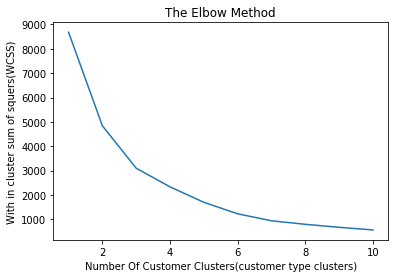

In [88]:
plt.plot(range(1,11) , wcss)
plt.title('The Elbow Method')
plt.xlabel('Number Of Customer Clusters(customer type clusters)')
plt.ylabel('With in cluster sum of squers(WCSS)')

> 시각화

In [64]:
# Elbo 포인트는 k=3 입니다.
kmeans = KMeans(n_clusters = 3, init = 'k-means++')
y_kmeans = kmeans.fit_predict(x)

In [65]:
y_kmeans

array([1, 0, 0, ..., 0, 0, 0], dtype=int32)

In [79]:
x[y_kmeans == 0,0]

array([ 0.25084866,  0.22769211, -0.1107498 , ..., -0.21525116,
        0.03293957,  0.07826308])

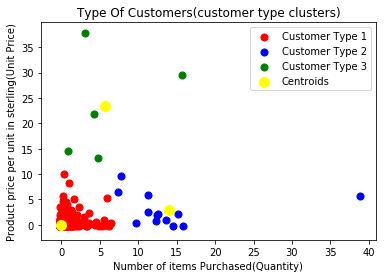

In [80]:
#x좌표 x[y_kmeans ==0,0], y좌표, x[y_kmeans==0,1]
plt.scatter(x[y_kmeans == 0, 0], x[y_kmeans == 0, 1], s = 50, c = 'red', label = 'Customer Type 1')
plt.scatter(x[y_kmeans == 1, 0], x[y_kmeans == 1, 1], s = 50, c = 'blue', label = 'Customer Type 2')
plt.scatter(x[y_kmeans == 2, 0], x[y_kmeans == 2, 1], s = 50, c = 'green', label = 'Customer Type 3')
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], s = 100, c = 'yellow', label = 'Centroids')
plt.title('Type Of Customers(customer type clusters)')
plt.xlabel('Number of items Purchased(Quantity)')
plt.ylabel('Product price per unit in sterling(Unit Price)')
plt.legend()

In [81]:
kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1]

(array([-0.04881459, 14.02904237,  5.71005511]),
 array([-0.03574775,  2.89386601, 23.36915616]))

In [100]:
x

array([[14.45293971, -0.32201021],
       [ 0.25084866,  0.22655054],
       [ 0.22769211, -0.11903463],
       ...,
       [-0.21525116, -0.25192212],
       [ 0.03293957,  1.01839182],
       [ 0.07826308, -0.20375726]])

In [105]:
len(x)

4339

Text(0, 0.5, 'Product price per unit in sterling(Unit Price)')

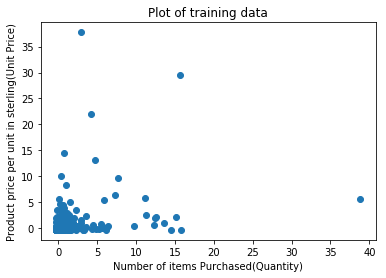

In [106]:
X=[];Y=[]
for i in range(4339):
    X.append(x[i][0])
    Y.append(x[i][1])
plt.scatter(X,Y)
plt.title('Plot of training data')
plt.xlabel('Number of items Purchased(Quantity)')
plt.ylabel('Product price per unit in sterling(Unit Price)')